# CAN Coach Bagfile Analysis

In [1]:
# Install packages and restart the kernel and don't run this next second
!pip install -U bagpy
!pip install -U strym

Requirement already up-to-date: bagpy in /home/ivory/anaconda3/envs/dbn/lib/python3.7/site-packages/bagpy-0.4.1-py3.7.egg (0.4.1)


Requirement already up-to-date: strym in /home/ivory/anaconda3/envs/dbn/lib/python3.7/site-packages/strym-0.3.1-py3.7.egg (0.3.1)


In [4]:
import bagpy
from bagpy import bagreader
import pandas as pd
import seaborn as sea
import matplotlib.pyplot as plt
import numpy as np
from strym import strymread
import ntpath
import warnings
warnings.filterwarnings("ignore")
import seaborn as sea
import os

color_long = ["#46f0f0", '#3a86ff', '#463F1A','#60492C', '#ff0022', '#208AAE', '#0D2149',\
              '#9ff9c1','#cb9173','#fdcff3',\
              '#2c80ff','#ffab2b','#fffb00', '#06b4ff','#23d160',\
              '#264653','#E9C46A',"#7900D7", "#A77500", "#6367A9", \
              "#A05837", "#772600", "#9B9700",'#E76F51',\
              '#B07BAC',"#7A87A1",'#5F7367','#472836',\
              "#00489C","#CB7E98", "#6F0062", "#EEC3FF",\
          '#97D8B2','#17BEBB','#C4A69D','#a3a271','#000000','#FFFFC7',\
          '#DB5461','#016FB9','#E56399','#D17B0F','#FFFC31','#772F1A',\
          '#808080','#000000', "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", \
          "#008941", "#006FA6", "#A30059","#FFDBE5", "#7A4900", "#0000A6", \
          "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87","#5A0007", \
          "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF","#4A3B53", \
          "#FF2F80","#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", \
          "#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",\
          "#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",\
          "#456D75", "#B77B68", "#788D66",\
          "#885578", "#FAD09F", "#1F819A", "#D157A0", "#BEC459", "#000080", "#0086ED", "#886F4C",\
          "#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",\
          "#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",\
          "#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",\
          "#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",\
          "#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#324E72"]

Failed to load Python extension for LZ4 support. LZ4 compression will not be available.


Loading BokehJS ...

In [5]:
DataFolder = "../Jmscslgroup/PandaData/CanCoachExperiment/"
import glob
baglist = glob.glob(DataFolder+"*.bag")
baglist  = sorted(baglist, key = lambda x: x.split('ID')[1]) 

In [6]:
baglist

['../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-19-08-15-ID1.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-13-13-20-53-ID2.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-18-51-06-ID3.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-15-23-39-10-ID4.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-38-29-ID5.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-36-31-ID6.bag']

In [7]:
b0 = bagreader(baglist[0])
b1 = bagreader(baglist[1])
b2 = bagreader(baglist[2])
b3 = bagreader(baglist[3])
b4 = bagreader(baglist[4])
b5 = bagreader(baglist[5])

b0.topic_table

[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-19-08-15-ID1 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-13-13-20-53-ID2 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-18-51-06-ID3 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-15-23-39-10-ID4 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-38-29-ID5 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-36-31-ID6 already exists. Not creating.


,Topics,Types,Message Count,Frequency
0,/ego_dist_traveled,geometry_msgs/PointStamped,6631,12.482769
1,/feedback_type,std_msgs/UInt8,6767,2.000012
2,/ghostTh,std_msgs/Float64,796,1.299754
3,/ghost_dist_traveled,geometry_msgs/PointStamped,6026,9.953142
4,/ghost_vehicle/vel,geometry_msgs/TwistStamped,21335,39.972401
5,/highbeams,geometry_msgs/Twist,3389,1.000019
6,/mode,std_msgs/UInt8,6767,2.000011
7,/modeChanger,std_msgs/Int8,301531,101.512755
8,/relv,std_msgs/Float64,15686,4.987958
9,/rosout,rosgraph_msgs/Log,1578,1.268797


In [8]:
def th_kde_plot(b):
    
    filename = ntpath.basename(b.bagfile)
    ID = filename[filename.find('ID'):filename.find('ID')+3]
    
    
    speed_file = b.message_by_topic('/vehicle/vel')
    accel_file = b.message_by_topic('/vehicle/accel')
    accel = pd.read_csv(accel_file)

    speed = pd.read_csv(speed_file)
    space_gap_file = b.message_by_topic('/space_gap')
    space_gap = pd.read_csv(space_gap_file)
    
    ghost_file = b.message_by_topic('/ghostTh')
    ghost = pd.read_csv(ghost_file)

    
    strymread.ranalyze(speed, title='Speed')
    strymread.ranalyze(space_gap, title='Space Gap')

    speed_resampled, spacegap_resampled = strymread.ts_sync(
        speed.rename(columns={"twist.linear.x": "Message"}), 
        space_gap.rename(columns={"data": "Message"}), rate = 5, method='nearest')

    fig, ax = bagpy.create_fig(1)
    ax[0].scatter( x = 'Time', y = 'twist.linear.x', data = speed, s = 3, marker = 'o', label = 'Original Speed')
    ax[0].scatter(x = 'Time', y = 'Message', data = speed_resampled,s = 1, alpha = 0.5, marker = 'x', label='Speed resampled at 5 Hz')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('m/s')
    fig.show()

    fig, ax = bagpy.create_fig(1)
    ax[0].scatter( x = 'Time', y = 'data', data = space_gap, s = 3, marker = 'o', label = 'Original space gap')
    ax[0].scatter(x = 'Time', y = 'Message', data = spacegap_resampled,s = 1, alpha = 0.5, marker = 'x', 
                  label='space gap resampled at 5 Hz')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('m')
    fig.show()

    timeheadway = pd.DataFrame()
    timeheadway['Time'] = spacegap_resampled['Time']
    timeheadway['Message'] = spacegap_resampled['Message']/speed_resampled['Message']
    timeheadway.replace([np.inf, -np.inf], np.nan, inplace = True)
    timeheadway.dropna(inplace=True)

    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'Message', data= timeheadway, s = 1, c = 'Time', cmap = strymread.sunset, label = 'Time Headway')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('seconds')
    ax[0].set_title(ntpath.basename(b.filename))
    fig.show()
    
    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'accel.linear.x', data= accel, s = 1, c = 'Time', cmap = strymread.sunset, 
                  label = 'Acceleration')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('seconds')
    ax[0].set_title(ntpath.basename(b.filename))
    fig.show()
    
    setpoint_file = b.message_by_topic('/setpoint')
    mode_file = b.message_by_topic('/mode')
    relv_file = b.message_by_topic('/relv')
    mode = pd.read_csv(mode_file)
    setpoint = pd.read_csv(setpoint_file)
    relv = pd.read_csv(relv_file)

    setpoint_resample, timeheadway_resampled = strymread.ts_sync(
        setpoint.rename(columns={"data": "Message"}), 
        timeheadway, rate = 1, method='nearest')

    mode_resampled, _ = strymread.ts_sync(
        mode.rename(columns={"data": "Message"}), 
        timeheadway, rate = 1, method='nearest')

    relv_resampled, _ = strymread.ts_sync(
        relv.rename(columns={"data": "Message"}), 
        setpoint_resample, rate = 'second', method='nearest')
    
    ghost_resampled, _ = strymread.ts_sync(
        ghost.rename(columns={"data": "Message"}), 
        setpoint_resample, rate = 'second', method='nearest')

    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'Message', data = setpoint_resample, s = 1, label = 'Set Point')
    ax[0].scatter(x = 'Time', y = 'Message', data = timeheadway_resampled, s = 1, label = 'Timeheadway (s)')
    ax[0].scatter(x = 'Time', y = 'Message', data = mode_resampled, s = 1, label = 'Mode')
    ax[0].scatter(x = 'Time', y = 'Message', data = relv_resampled, s = 1, label = 'Relative Velocity')
    ax[0].scatter(x = 'Time', y = 'Message', data = ghost_resampled, s = 1, label = 'Ghost TH')
    ax[0].set_xlabel('Time')
    
    ax[0].legend()
    fig.show()


    # Construct a joint dataframe consisting of setpoints and timeheadway
    setpoint_th = pd.DataFrame()
    setpoint_th['Time'] = setpoint_resample['Time']
    setpoint_th['setpoint'] = setpoint_resample['Message']
    setpoint_th['timeheadway'] = timeheadway_resampled['Message']
    setpoint_th['mode'] = mode_resampled['Message']
    setpoint_th['relv'] = relv_resampled['Message']
    setpoint_th['ghosth'] = ghost_resampled['Message']


    modes = setpoint_th['mode'].unique()
    mode_dict = {1: 'Normal Driving', 6: 'Instructed Velocity Matching', 
            7: 'Coached Velocity Matching', 2: 'Constant Time Headway',
            3: 'Coached Constant Time Headway', 4: 'Instructed Dynamic Time Headway',
            5: 'Coach Dynamic Time Headway', 8: 'Ghost'}
    

    nc = int( np.sqrt(len(modes)))+1
    fig, ax = strymread.create_fig(ncols = 2)
    fig.set_figwidth(30)
    fig.set_figheight(12)
    k = 0
    for i, m in enumerate(modes):
        setpoint_mode = setpoint_th[setpoint_th['mode'] == m]
        
        sp = setpoint_mode['setpoint'].unique()
        for s in sp:
            sp_mode = setpoint_mode[setpoint_mode['setpoint'] == s]
#            if m == 6 or m == 7:
            #sp_mode1  = sp_mode[sp_mode.relv < sp_mode.relv.quantile(.7)]
            sp_mode1 = sp_mode[sp_mode.relv.between(sp_mode.relv.quantile(.05), sp_mode.relv.quantile(.95))] # without outliers
            sea.kdeplot(data=sp_mode1, x="relv", 
                        label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                        fill=True, common_norm=False, palette="Paired", 
                        alpha=.5, linewidth=0, ax = ax[0])
            if m == 8:
                sp_mode1 = sp_mode[sp_mode.ghosth.between(sp_mode.ghosth.quantile(.05), sp_mode.ghosth.quantile(.95))] # without outliers
                sea.kdeplot(data=sp_mode1, x="ghosth",
                            label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                            fill=True, common_norm=False, palette="Paired", 
                            alpha=.5, linewidth=0, ax = ax[1])
            else:
                sp_mode1 = sp_mode[sp_mode.timeheadway.between(sp_mode.timeheadway.quantile(.05), sp_mode.timeheadway.quantile(.95))] # without outliers
                sea.kdeplot(data=sp_mode1, x="timeheadway",
                            label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                            fill=True, common_norm=False, palette="Paired", 
                            alpha=.5, linewidth=0, ax = ax[1])
            k =k +1 
            
    ax[0].legend(loc = 'upper left', fontsize = 16)
    ax[1].legend(loc = 'upper left', fontsize = 16)
    
    ax[0].set_title("Relative Velocity Distribution")
    ax[1].set_title("Time headway Distribution")
    my_suptitle = fig.suptitle(ID, y = 1.01)
    fig.savefig('figures/densityPlot-I_{}.png'.format(ntpath.basename(b.bagfile[0:-4])),
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()
    
    #####################################################################
    fig, ax = strymread.create_fig(nrows = nc, ncols = nc)
    fig.set_figwidth(35)
    fig.set_figheight(35)
    for i, m in enumerate(modes):
        setpoint_mode = setpoint_th[setpoint_th['mode'] == m]

        if m == 6 or m == 7:
            sea.kdeplot(data=setpoint_mode, x="relv", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        elif m == 8:
            sea.kdeplot(data=setpoint_mode, x="ghosth", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        else:
            sea.kdeplot(data=setpoint_mode, x="timeheadway", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        ax[i].set_title("Mode: {}".format(mode_dict[m]))

    my_suptitle = fig.suptitle(ID, y = 1.02)
    fig.savefig('figures/densityPlot-II_{}.png'.format(ntpath.basename(b.bagfile[0:-4])),
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()

In [55]:
def multi_bag_kde(bs):
    
    ## For relative velocity KDE plot
    fig, ax = strymread.create_fig(nrows = 4, ncols = 2)
    fig.set_figwidth(25)
    fig.set_figheight(30)
    
    ## For space gap KDE plot
    fig2, ax2 = strymread.create_fig(nrows = 4, ncols = 2)
    fig2.set_figwidth(25)
    fig2.set_figheight(28)
    
    ## For timeheadway error KDE plot
    fig3, ax3 = strymread.create_fig(nrows = 4, ncols = 2)
    fig3.set_figwidth(25)
    fig3.set_figheight(28)
    
    ## For velocity timeseries
    fig4, ax4 = strymread.create_fig(nrows = 6, ncols = 1)
    fig4.set_figwidth(20)
    fig4.set_figheight(50)
    
    ## For relative velocity timeseries
    fig5, ax5 = strymread.create_fig(nrows = 6, ncols = 1)
    fig5.set_figwidth(20)
    fig5.set_figheight(50)
    
    ## For spacegap error KDE plot
    fig6, ax6 = strymread.create_fig(nrows = 4, ncols = 2)
    fig6.set_figwidth(25)
    fig6.set_figheight(28)
    
#     ## For relative velocity timeseries
#     fig, ax5 = strymread.create_fig(nrows = 6, ncols = 1)
#     fig5.set_figwidth(20)
#     fig5.set_figheight(50)
    
    k = 0

    
    ID_Color = [["#ff7b00", '#9b5de5', '#297837','#60492C', '#ff0022', 
                 '#208AAE', '#0D2149', "#02c39a", "#e0aaff", "#46f0f0"],
                ['#9ff9c1','#cb9173','#fdcff3','#2c80ff','#ffab2b','#b50033']]
    
    dashes = [[1, 3, 1, 3], [3, 3, 3, 3], [8, 3, 1, 3], 
              [6, 0, 6, 1], [10, 0, 20, 0], [10, 4, 20, 1], [1, 3, 1, 3]]
    
    thickness = [3.0, 2.5, 3.0, 3.5, 4.0, 4.5, 2.0]
    
    markers = ["o", ".", "v", "8", "s", '*', "D", "H", "o"]
    
    mode_dict = {1: 'Normal Driving', 6: 'Instructed Velocity Matching', 
            7: 'Coached Velocity Matching', 2: 'Constant Time Headway',
            3: 'Coached Constant Time Headway', 4: 'Instructed Dynamic Time Headway',
            5: 'Coach Dynamic Time Headway', 8: 'Ghost'}
    

    
    for b in bs:
        filename = ntpath.basename(b.bagfile)
        ID = filename[filename.find('ID'):filename.find('ID')+3]
        print(ID)
        CID = int(ID[2:])-1
        speed_file = b.message_by_topic('/vehicle/vel')
        speed = pd.read_csv(speed_file)
        space_gap_file = b.message_by_topic('/space_gap')
        space_gap = pd.read_csv(space_gap_file)
        ghost_file = b.message_by_topic('/ghostTh')
        ghost = pd.read_csv(ghost_file)

        ghostvel_file = b.message_by_topic('/ghost_vehicle/vel')
        ghostvel = pd.read_csv(ghostvel_file)
    
        speed_resampled, spacegap_resampled = strymread.ts_sync(
            speed.rename(columns={"twist.linear.x": "Message"}), 
            space_gap.rename(columns={"data": "Message"}), rate = 5, method='nearest')
        
        timeheadway = pd.DataFrame()
        timeheadway['Time'] = spacegap_resampled['Time']
        timeheadway['Message'] = spacegap_resampled['Message']/speed_resampled['Message']
        timeheadway.replace([np.inf, -np.inf], np.nan, inplace = True)
        timeheadway.dropna(inplace=True)
        
        setpoint_file = b.message_by_topic('/setpoint')
        mode_file = b.message_by_topic('/mode')
        relv_file = b.message_by_topic('/relv')
        mode = pd.read_csv(mode_file)
        setpoint = pd.read_csv(setpoint_file)
        relv = pd.read_csv(relv_file)

        setpoint_resample, timeheadway_resampled = strymread.ts_sync(
            setpoint.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        
        setpoint_resample, timeheadway_resampled = strymread.ts_sync(
            setpoint.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        

        mode_resampled, _ = strymread.ts_sync(
            mode.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        

        spacegap_resampled, _ = strymread.ts_sync(
            space_gap.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        relv_resampled, _ = strymread.ts_sync(
            relv.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')

        ghost_resampled, _ = strymread.ts_sync(
            ghost.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        speed_resampled, _ = strymread.ts_sync(
            speed.rename(columns={"twist.linear.x": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        ghostvel_resampled, _ = strymread.ts_sync(
            ghostvel.rename(columns={"twist.linear.x": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        # Construct a joint dataframe consisting of setpoints and timeheadway
        setpoint_th = pd.DataFrame()
        setpoint_th['Time'] = setpoint_resample['Time']
        setpoint_th['setpoint'] = setpoint_resample['Message']
        setpoint_th['timeheadway'] = timeheadway_resampled['Message']
        setpoint_th['mode'] = mode_resampled['Message']
        setpoint_th['relv'] = relv_resampled['Message']
        setpoint_th['ghosth'] = ghost_resampled['Message']
        setpoint_th['spacegap'] = spacegap_resampled['Message']
        setpoint_th['speed'] = speed_resampled['Message']
        setpoint_th['ghostvel'] = ghostvel_resampled['Message']
        
        setpoint_th['desired_spacegap'] = setpoint_th['setpoint']*(setpoint_th['speed'] + setpoint_th['relv'])
        setpoint_th['spacegap_error'] = setpoint_th['desired_spacegap'] - setpoint_th['spacegap']
        
        # Remove outliers based on speed measurement
        setpoint_th = setpoint_th[setpoint_th.speed.between
                             (
                            setpoint_th.speed.quantile(.10), setpoint_th.speed.quantile(1)
                            )
                        ]
        
        setpoint_th = setpoint_th[setpoint_th.relv.between
                             (
                            setpoint_th.relv.quantile(.05), setpoint_th.relv.quantile(0.99)
                            )
                        ]
        
        print(setpoint_th.shape)

        modes = setpoint_th['mode'].unique()
        
        for i, m in enumerate(modes):
            m = int(m)
            setpoint_mode = setpoint_th[setpoint_th['mode'] == m]
            sp = setpoint_mode['setpoint'].unique()
            
            sp_mode = setpoint_mode
            if m == 6 or m == 7:
                sp_mode1 = sp_mode
                if m == 7:
                    sp_mode1 = sp_mode1[sp_mode['Time'] - sp_mode['Time'].iloc[0] >= 360.0]
                else:
                    sp_mode1 = sp_mode[sp_mode['Time'] - sp_mode['Time'].iloc[0] >= 10.0]
                                
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity (m/)")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            label = '{}'.format(ID),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space Gap (m)")
                
                mean = np.mean(sp_mode1["timeheadway"])
                stddev = np.std(sp_mode1["timeheadway"])
                
                sea.kdeplot(data=sp_mode1["timeheadway"]- 2.25, 
                            #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            label = '{}'.format(ID),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax3[i], color = ID_Color[0][CID])
                
                ax3[i].set_xlabel("Time Gap Error (s)")
                
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time (s)")
        
                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time")
                
                mean = np.mean(sp_mode1["spacegap_error"])
                stddev = np.std(sp_mode1["spacegap_error"])
                
                #print("ID:{}, mode: {}, mean: {}, stddev: {}".format(CID, m, mean, stddev))
                
                sea.kdeplot(data=sp_mode1, x="spacegap_error", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Space Gap Error (m)")
                
                
            elif m == 8:
        
                if len(sp_mode.setpoint.unique())  == 1:
                    sp_mode1 = sp_mode   #.iloc[10:]
                else:
                    sp_mode1 = sp_mode[sp_mode.setpoint == 2.25]
                    sp_mode2 = sp_mode[sp_mode.setpoint == 1.8]

                    assert(len(sp_mode1.setpoint.unique())  == 1), 'Problem filtering on setpoint 2.25'
                    assert(len(sp_mode2.setpoint.unique())  == 1), 'Problem filtering on setpoint 1.8'

                    sp_mode1 = pd.concat([sp_mode1, sp_mode2])
                
                
                ## Remove everything after 360 seconds
                sp_mode1 = sp_mode1.iloc[11:360]
                
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity (m/s)")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            label = '{}'.format(ID),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space Gap (m)")
                
                mean = np.mean(sp_mode1["ghosth"] - sp_mode1['setpoint'])
                stddev = np.std(sp_mode1["ghosth"] - sp_mode1['setpoint'])
                
                sea.kdeplot(data=sp_mode1["ghosth"] - sp_mode1['setpoint'],dashes = dashes[CID],
                            #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            label = '{}'.format(ID),
                            fill=False, common_norm=False, 
                            alpha=.75, linewidth=4, ax = ax3[i], color = ID_Color[0][int(ID[2:])-1])
                ax3[i].set_xlabel("Ghost Timegap Error (s)")
                
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m],  linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time (s)")

                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m],  linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time (s)")
                
                ghost_space_gap_error = (sp_mode1["setpoint"]*sp_mode1["ghostvel"]) - sp_mode1['spacegap']
                
                mean = np.mean(ghost_space_gap_error)
                stddev = np.std(ghost_space_gap_error)
                #print("ID:{}, mode: {}, mean: {}, stddev: {}".format(CID, m, mean, stddev))
                sea.kdeplot(data=sp_mode1, x=ghost_space_gap_error, 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Ghost Space Gap Error (m)")
                
            else:              
                
                if len(sp_mode.setpoint.unique())  == 1:
                    sp_mode1 = sp_mode.iloc[10:]
                else:
                    sp_mode1 = sp_mode[sp_mode.setpoint == 2.25]
                    sp_mode1 = sp_mode1.iloc[10:]
                    sp_mode2 = sp_mode[sp_mode.setpoint == 1.8]
                    sp_mode2 = sp_mode2.iloc[10:]
                    assert(len(sp_mode1.setpoint.unique())  == 1), 'Problem filtering on setpoint 2.25'
                    assert(len(sp_mode2.setpoint.unique())  == 1), 'Problem filtering on setpoint 1.8'

                    sp_mode1 = pd.concat([sp_mode1, sp_mode2])
                    
                    
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity (m/s)")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            label = '{}'.format(ID),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space Gap (m)")
                
                
                mean = np.mean(sp_mode1["timeheadway"] - sp_mode1['setpoint'])
                stddev = np.std(sp_mode1["timeheadway"] - sp_mode1['setpoint'])
                
                #print("ID: {}, Mode: {}".format(ID, m))
                #print(sp_mode1["timeheadway"]- sp_mode1['setpoint'])
                
                if m in [2, 3]:
                
                    sea.kdeplot(data=sp_mode1["timeheadway"]- 2.25, dashes = dashes[CID],
                                #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                                label = '{}'.format(ID),
                                fill=False, common_norm=False, 
                            alpha=.75, linewidth=4, ax = ax3[i], color = ID_Color[0][int(ID[2:])-1])

                else:
                    sea.kdeplot(data=sp_mode1["timeheadway"]- sp_mode1['setpoint'], dashes = dashes[CID],
                                #label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                                label = '{}'.format(ID),
                                fill=False, common_norm=False, 
                            alpha=.75, linewidth=4, ax = ax3[i], color = ID_Color[0][int(ID[2:])-1])

                
                ax3[i].set_xlabel("Time Gap Error (s)")
                if m == 1:
                    ax3[i].set_xlabel("Time Gap (s)")
                    
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time (s)")
                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))                
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time (s)")
                
                mean = np.mean(sp_mode1["spacegap_error"])
                stddev = np.std(sp_mode1["spacegap_error"])
                #print("ID:{}, mode: {}, mean: {}, stddev: {}".format(CID, m, mean, stddev))
                
                sea.kdeplot(data=sp_mode1, x="spacegap_error", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Space Gap Error (m)")
                
                k = k + 1
                
                
                
            ax[i].set_title("Mode: {}".format(mode_dict[m]))
            ax[i].set_xlim(-6, 6)
            ax[i].set_ylim(0, 1.5)
            ax[i].patch.set_alpha(0.0)
            ax[i].grid(False, which='both')
    
            #ax2[i].set_title("Mode: {}".format(mode_dict[m]))
            ax2[i].set_title("")
            
            ax2[i].set_xlim(0, 150)
            ax2[i].set_ylim(0, 0.16)
            ax2[i].patch.set_alpha(0.0)
            ax2[i].grid(False, which='both')
            ax2[i].tick_params(axis='both', which='major', labelsize=35)
            
            #ax3[i].set_title("Mode: {}".format(mode_dict[m]))
            ax3[i].set_title("")
            ax3[i].set_xlim(-2, 5)
            ax3[i].set_ylim(0, 4.5)
            ax3[i].patch.set_alpha(0.0)
            ax3[i].grid(False, which='both')
            ax3[i].tick_params(axis='both', which='major', labelsize=35)
            
            ax4[CID].set_title("{}".format(ID))
            ax4[CID].patch.set_alpha(0.0)
            ax4[CID].grid(False, which='both')
            
            ax5[CID].set_title("{}".format(ID))
            ax5[CID].patch.set_alpha(0.0)
            ax5[CID].grid(False, which='both')
            
            ax[i].legend(loc = 'upper right', fontsize = 20)
            ax2[i].legend(loc = 'upper right', fontsize = 20)
            ax3[i].legend(loc = 'upper right', fontsize = 20)
            ax4[CID].legend(loc = 'upper right', fontsize = 20, markerscale = 2, ncol=2)
            ax5[CID].legend(loc = 'upper right', fontsize = 20, markerscale = 2, ncol=2)
            ax6[i].legend(loc = 'upper right', fontsize = 20)
            
            ax4[CID].set_xlim(np.min(setpoint_th['Time'])-10, np.max(setpoint_th['Time'])+10)
            ax4[CID].set_ylim(np.min(setpoint_th['speed'])-15, np.max(setpoint_th['speed'])+15)
            ax5[CID].set_xlim(np.min(setpoint_th['Time'])-10, np.max(setpoint_th['Time'])+10)
            ax5[CID].set_ylim(np.min(setpoint_th['relv'])-5, np.max(setpoint_th['relv'])+5)
                
            ax6[i].set_title("Mode: {}".format(mode_dict[m]))
            ax6[i].set_xlim(-140, 140.0)
            ax6[i].set_ylim(0, 0.25)
            ax6[i].patch.set_alpha(0.0)
            ax6[i].grid(False, which='both')
                
#             if m == 6 or m == 7:
#                 ax2[int(7-m)].legend(loc = 'upper right', fontsize = 20)
#                 ax2[int(7-m)].set_title("Mode: {}".format(mode_dict[m]))
                
    
    my_suptitle = fig.suptitle('Aggregated Density Plot: relative velocity', y = 1.01)
    fig.savefig('figures/densityPlot-Aggregated-relv.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.savefig('figures/densityPlot-Aggregated-relv.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()
    
    my_suptitle2 = fig2.suptitle('Aggregated Density Plot: space gap', y = 1.01)
    fig2.tight_layout()
    fig2.savefig('figures/densityPlot-Aggregated-spacegap.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle2])
    fig2.savefig('figures/densityPlot-Aggregated-spacegap.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle2])
    fig2.show()
    
    my_suptitle3 = fig3.suptitle('Aggregated Density Plot: timegap error/timegap', y = 1.01)
    fig3.tight_layout()
    fig3.savefig('figures/densityPlot-Aggregated-timegap.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle3])
    fig3.savefig('figures/densityPlot-Aggregated-timegap.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle3])
    fig3.show()
    
    my_suptitle4 = fig4.suptitle('Speed Timeseries', y = 1.02)
    fig4.tight_layout()
    fig4.savefig('figures/speed-timeseries.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle4])
    fig4.savefig('figures/speed-timeseries.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle4])
    fig4.show()
    
    my_suptitle5 = fig5.suptitle('Relative Velocity Timeseries', y = 1.01)
    fig5.tight_layout()
    fig5.savefig('figures/relspeed-timeseries.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle5])
    fig5.savefig('figures/relspeed-timeseries.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle5])
    fig5.show()
    
    my_suptitle6 = fig6.suptitle('Aggregated Density Plot: space gap error', y = 1.01)
    fig6.tight_layout()
    fig6.savefig('figures/densityPlot-Aggregated-spacegap_error.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle6])
    
    fig6.savefig('figures/densityPlot-Aggregated-spacegap_error.pdf',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle6])
    fig6.show()

    return setpoint_th

## Specific Analysis
### Bag File with ID-1
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.414480498450693 


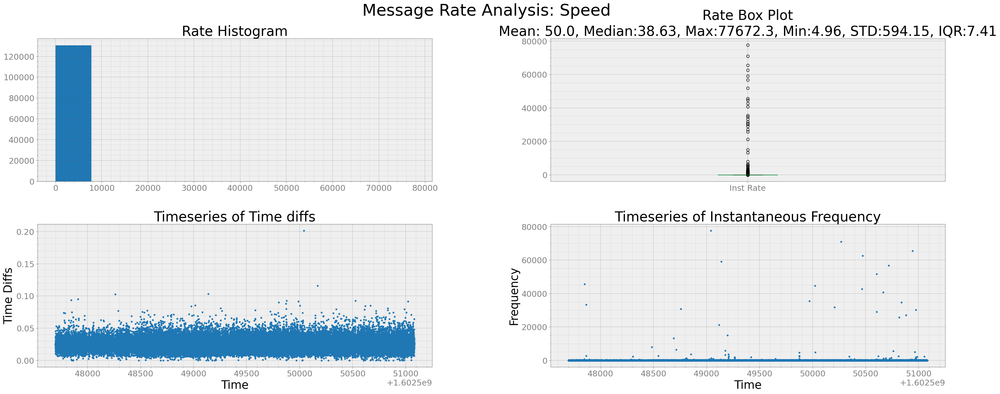

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.23320891629748353 


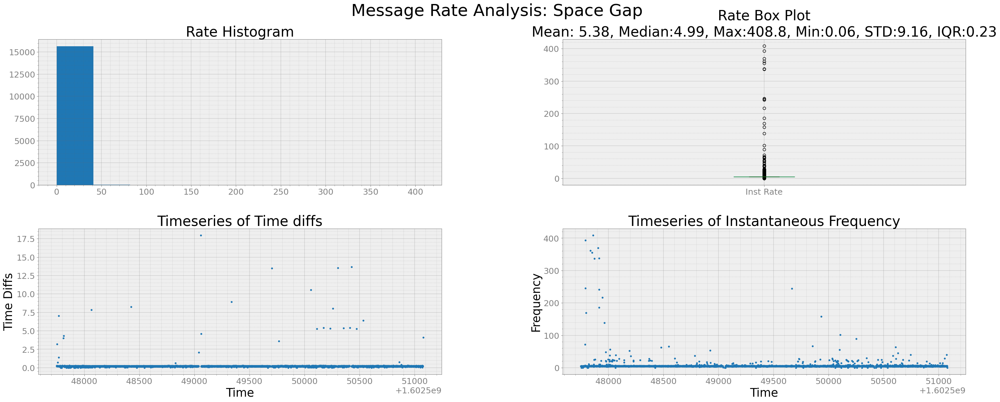

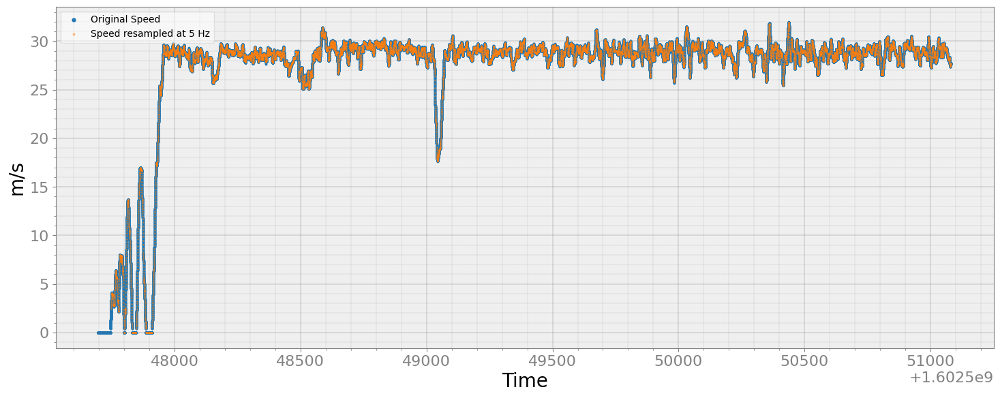

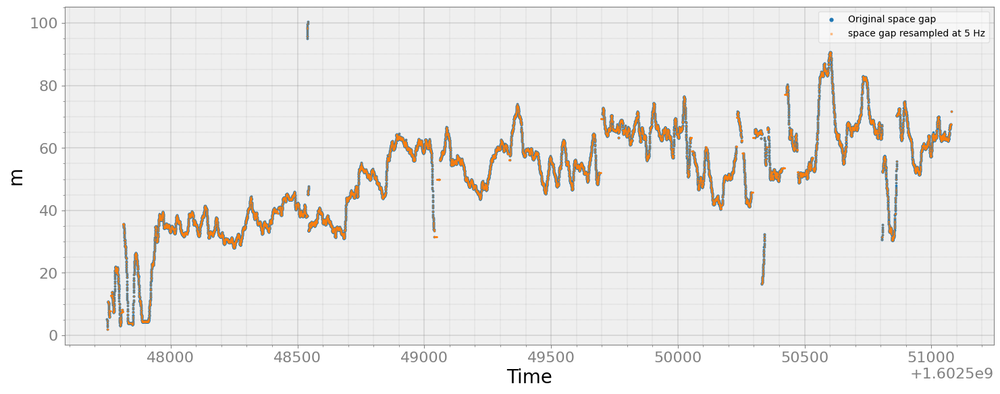

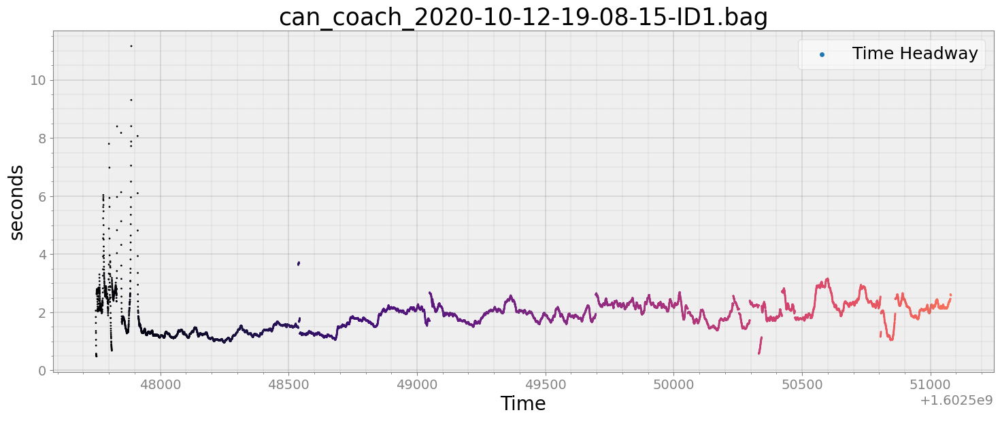

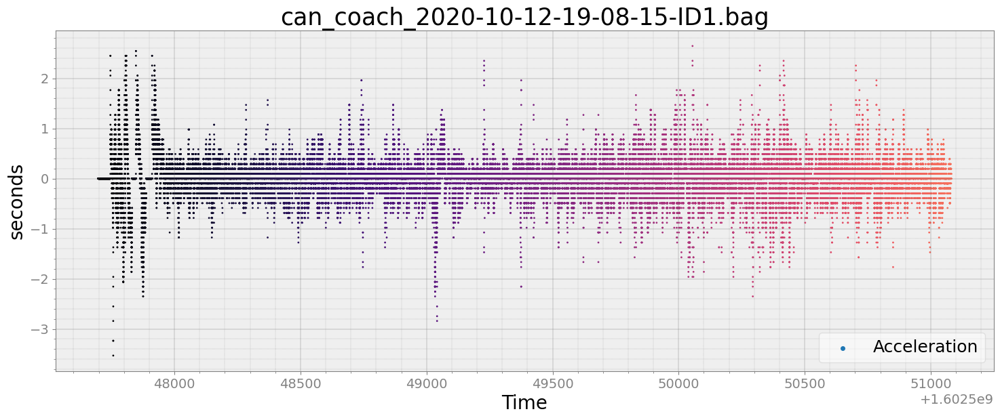

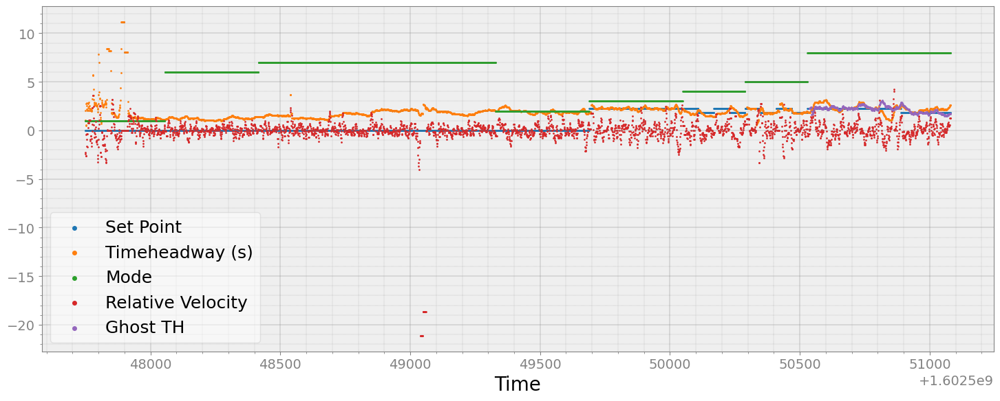

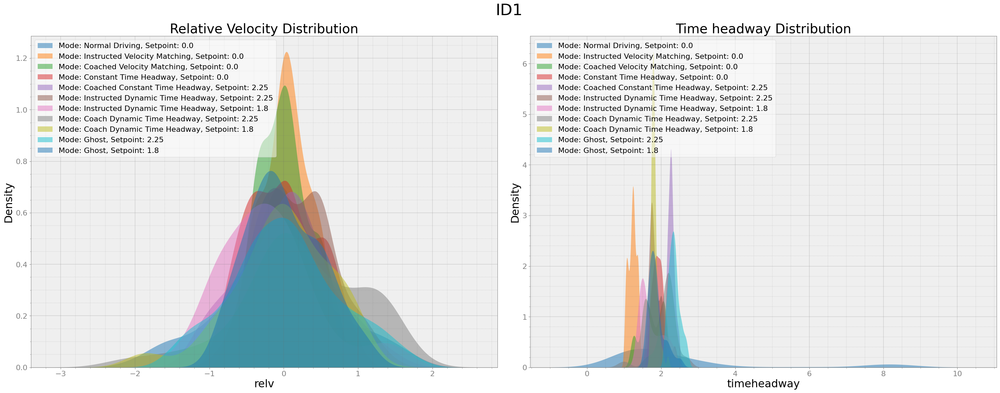

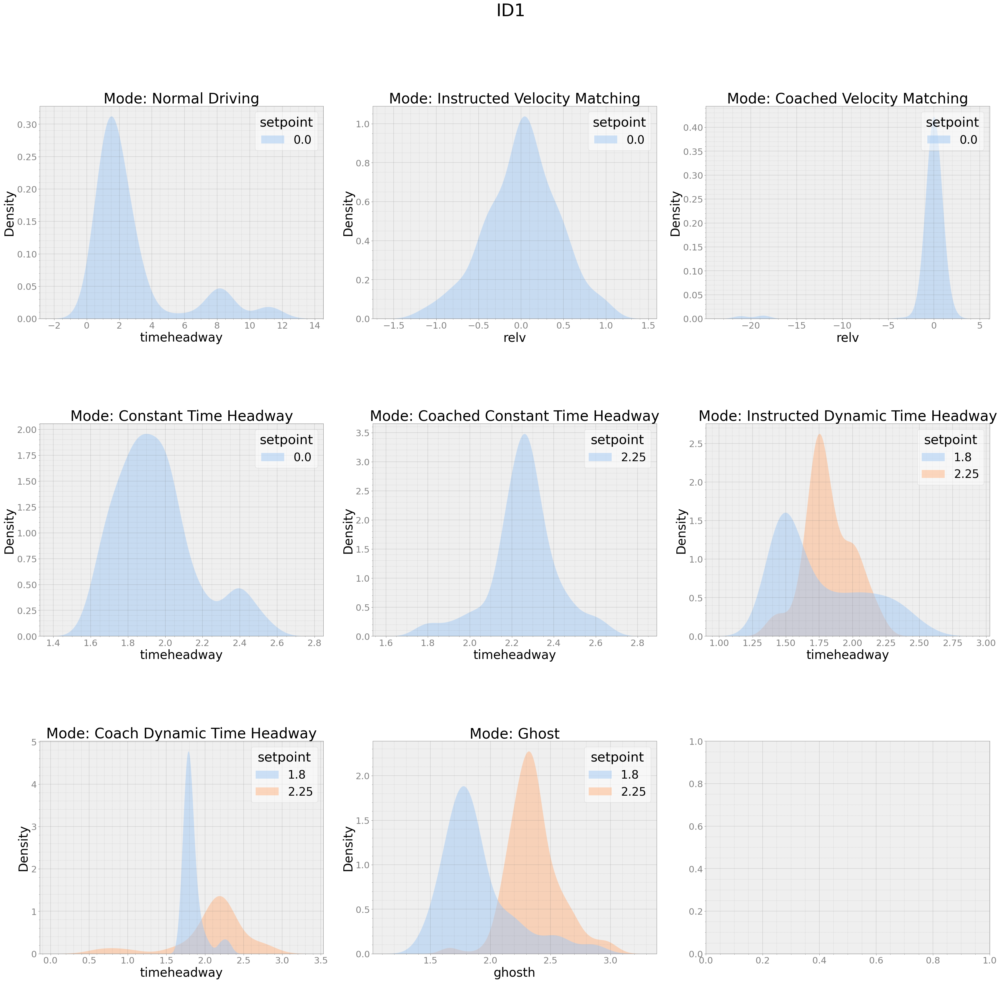

In [8]:
th_kde_plot(b0)

### Bag File with ID-2
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 9.339122652529781 


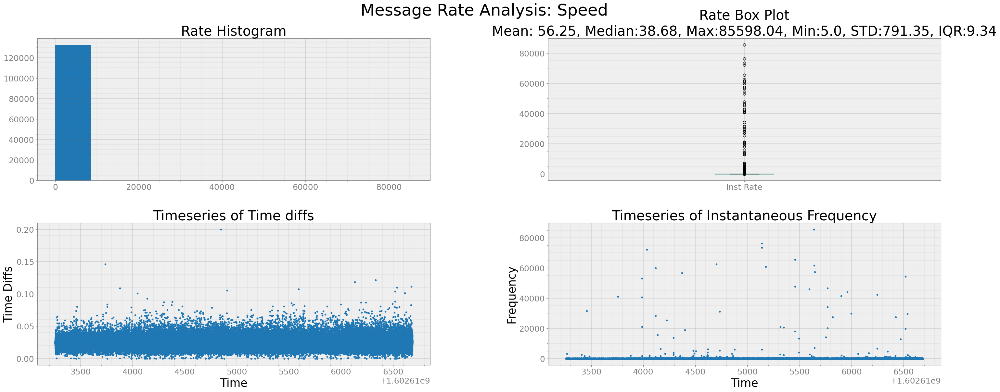

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.2818089978300389 


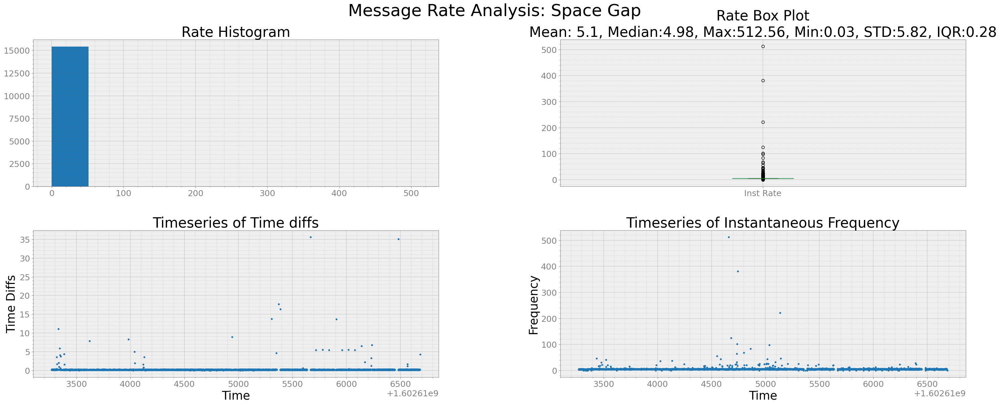

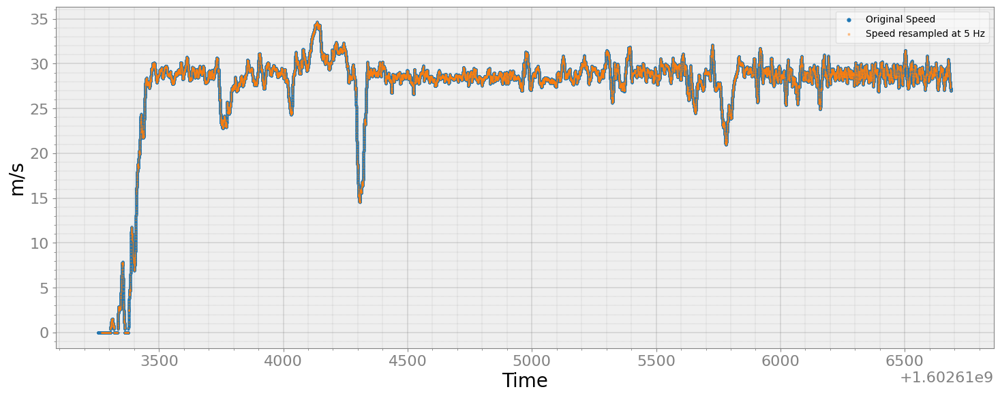

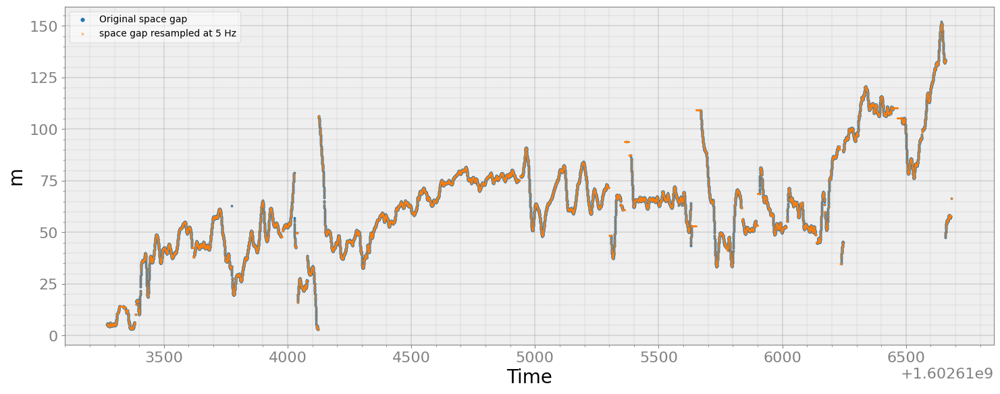

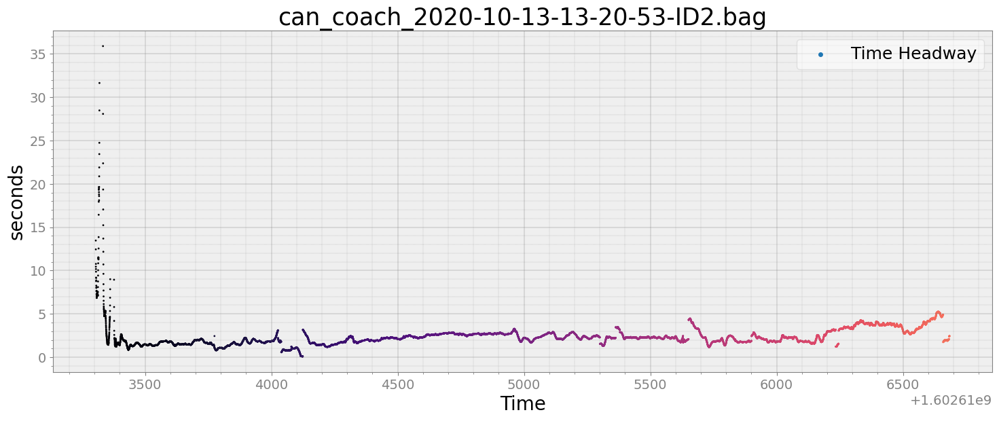

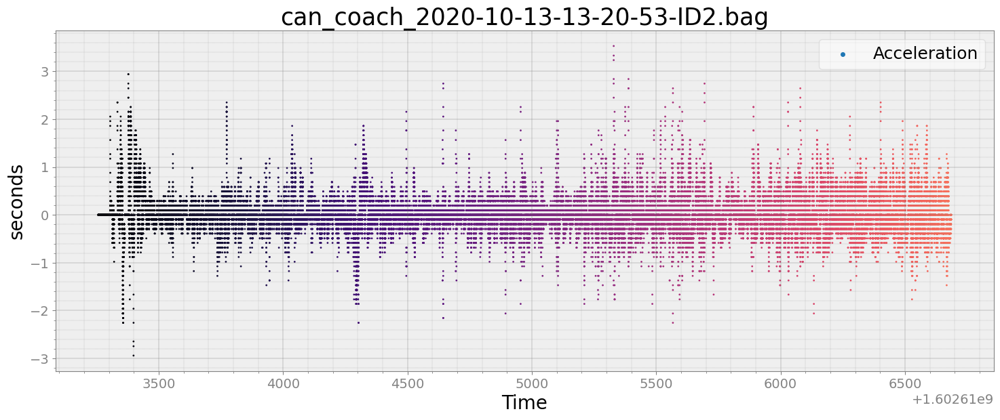

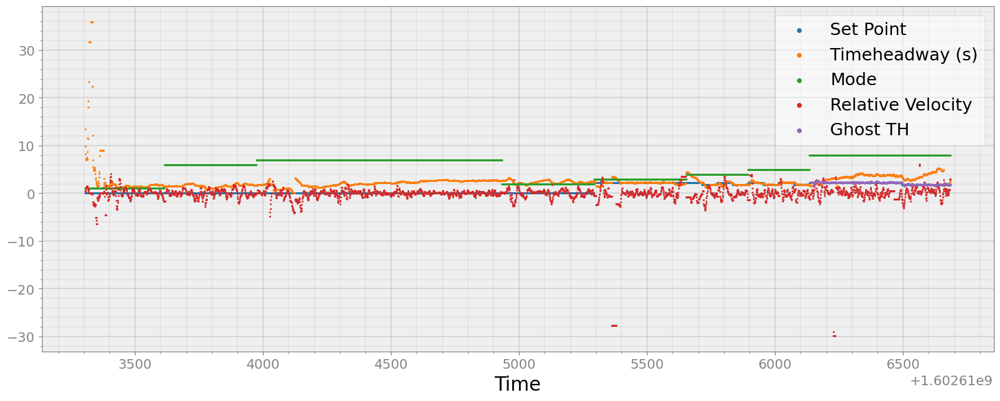

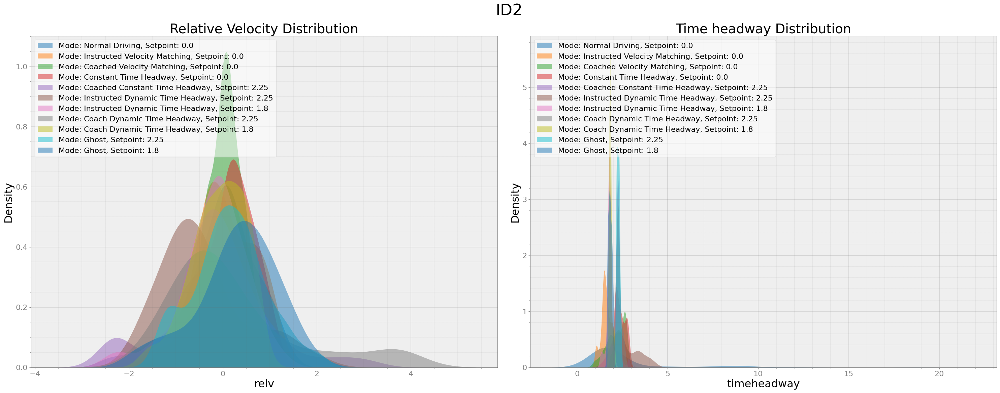

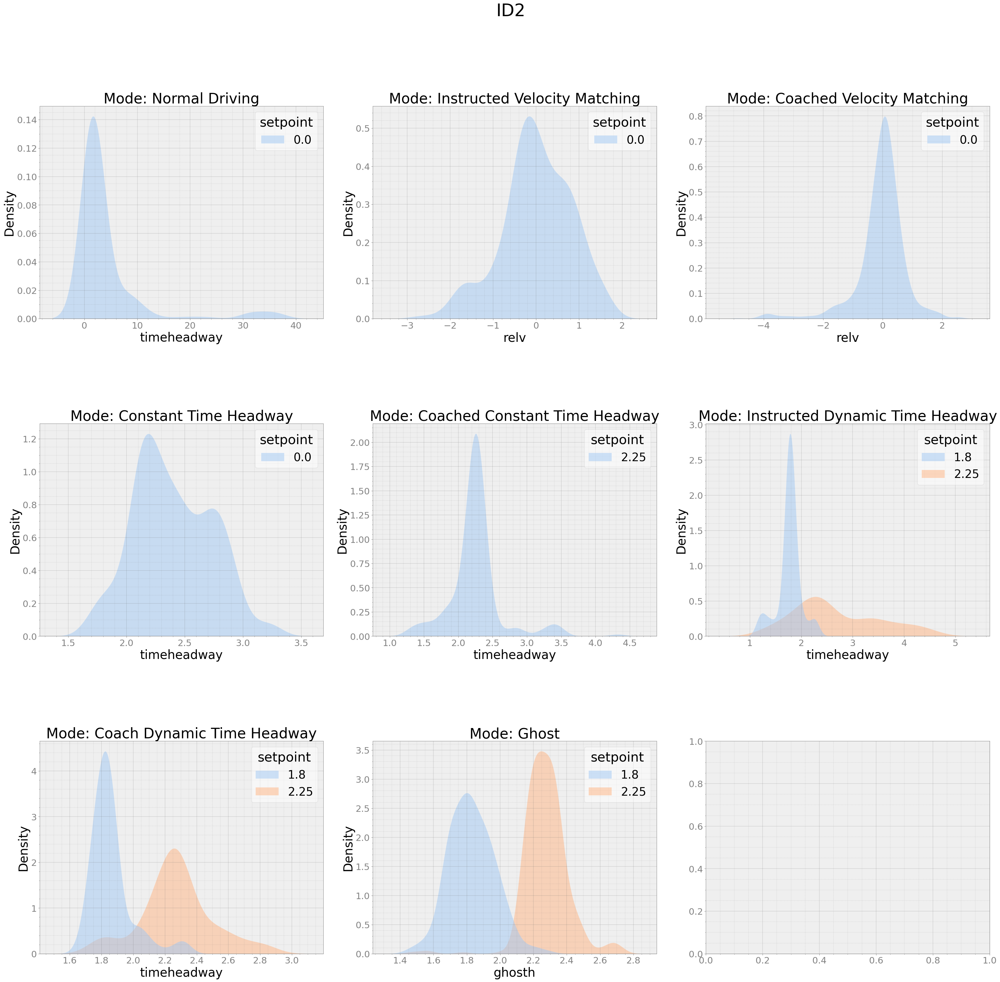

In [9]:
th_kde_plot(b1)

### Bag File with ID-3
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 8.258500774138874 


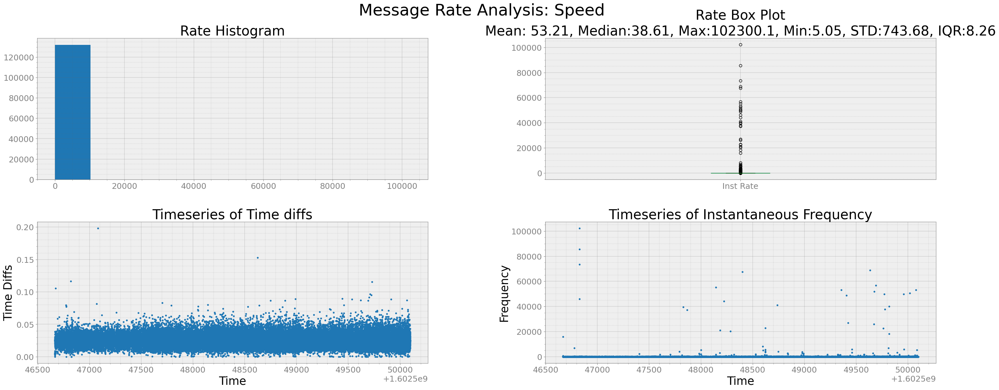

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.26193492586543066 


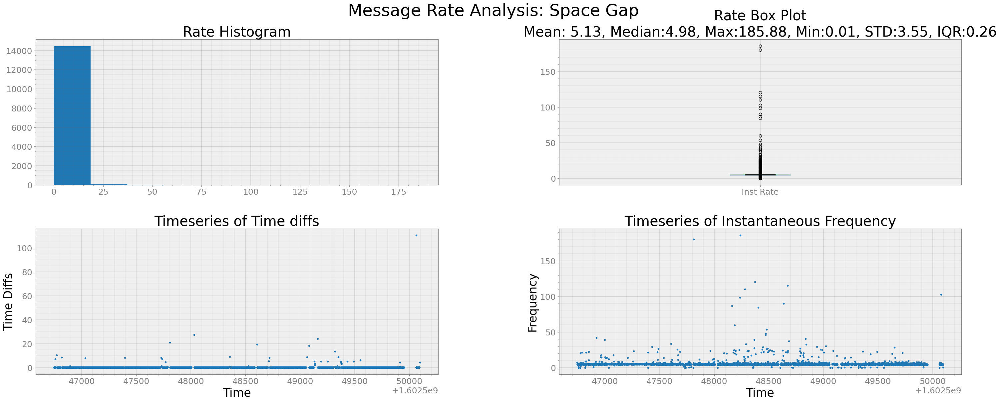

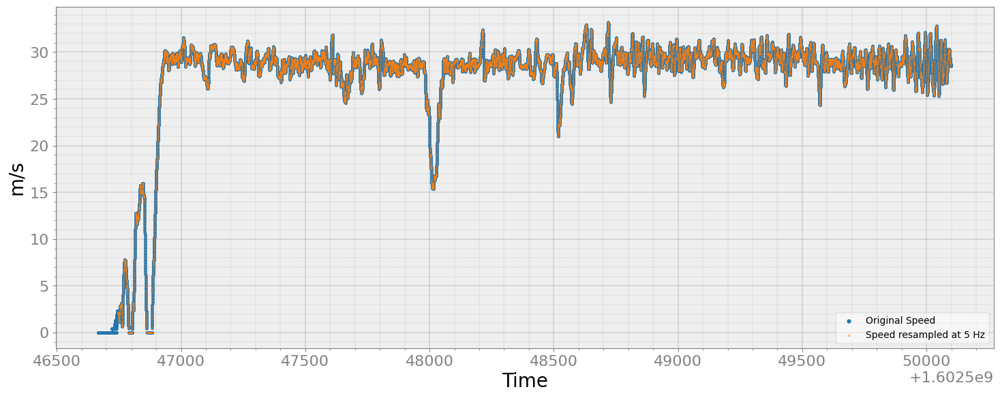

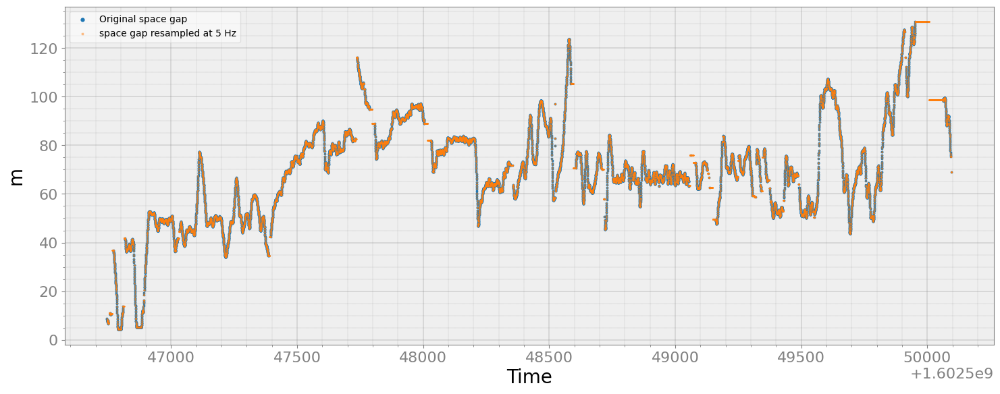

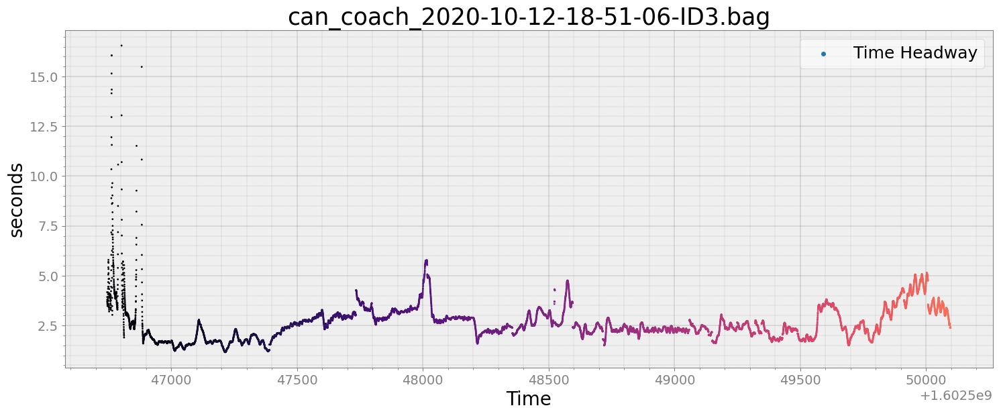

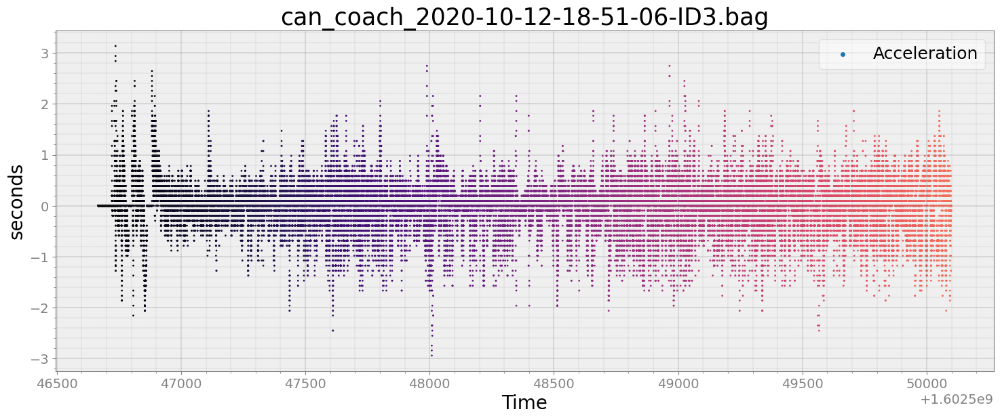

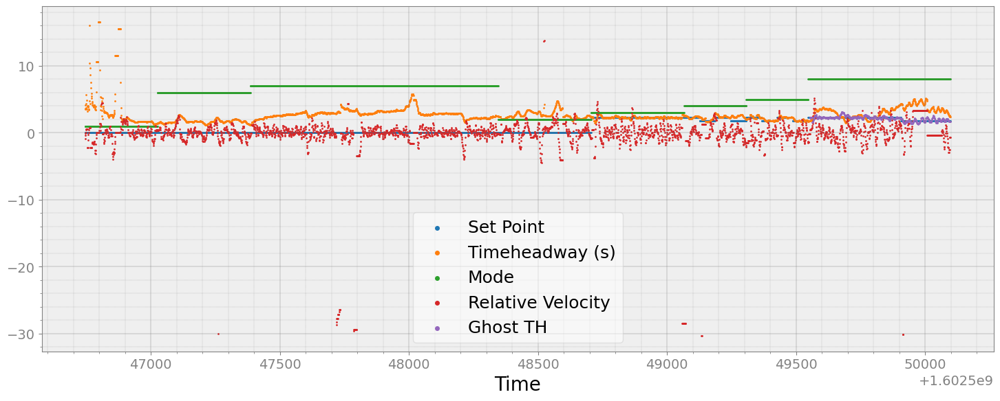

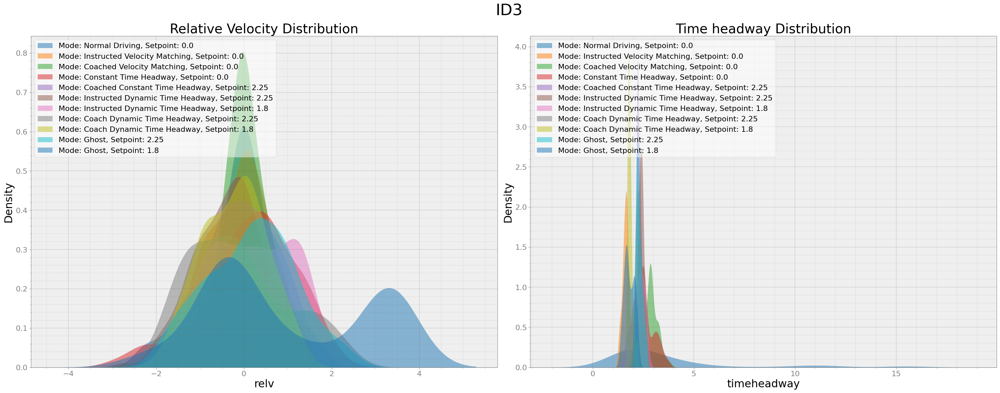

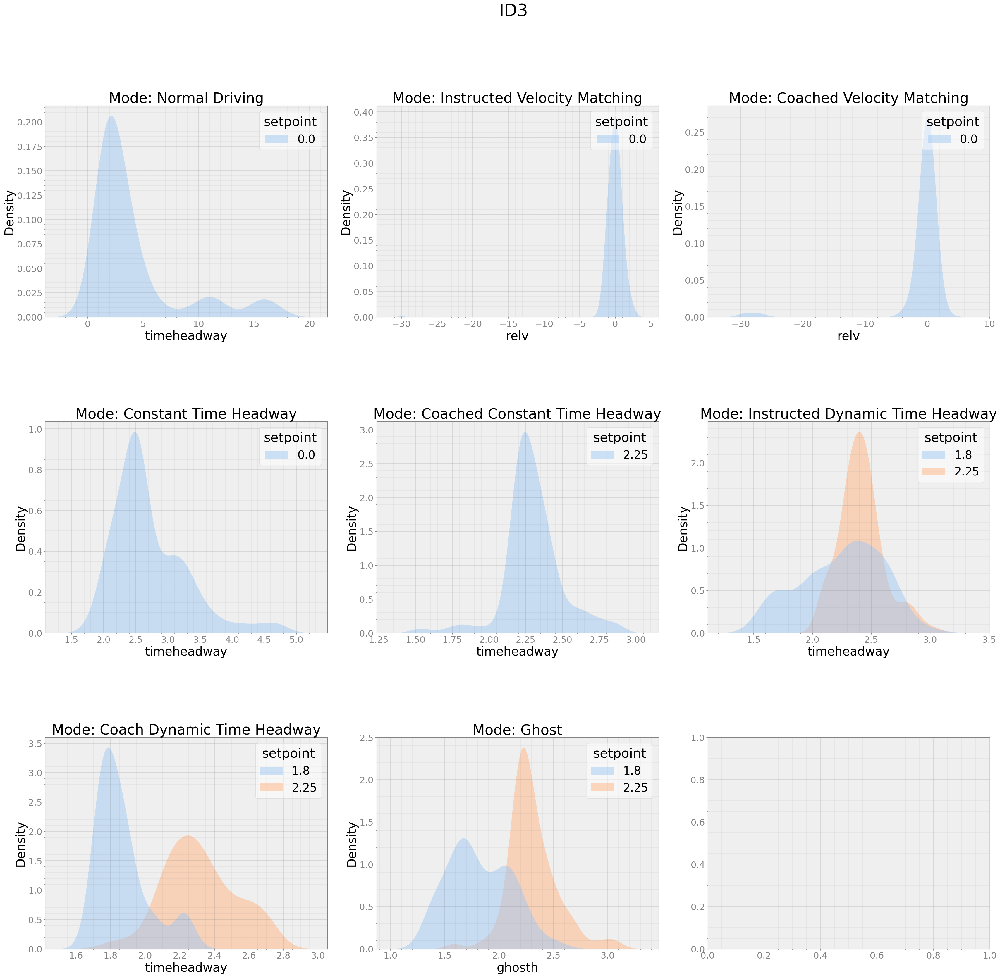

In [10]:
th_kde_plot(b2)

### Bag File with ID-4
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.308168848177637 


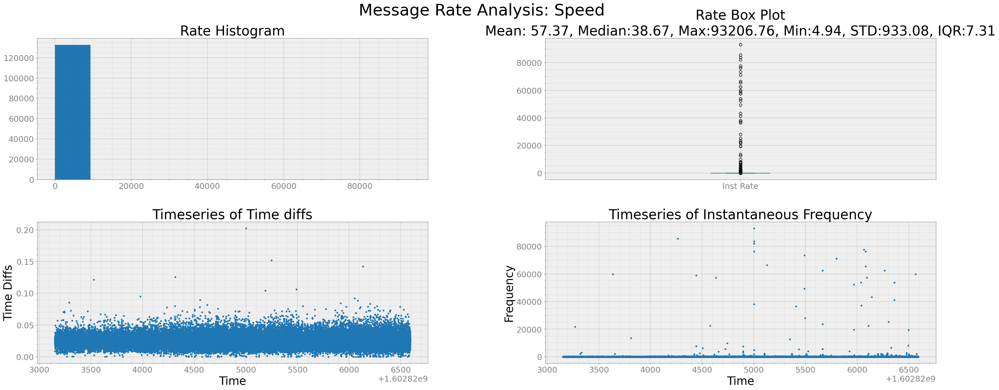

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.25073438079693666 


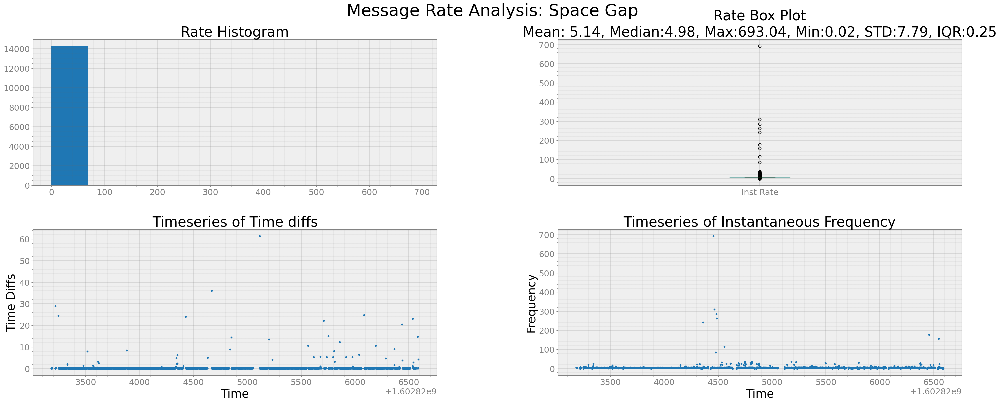

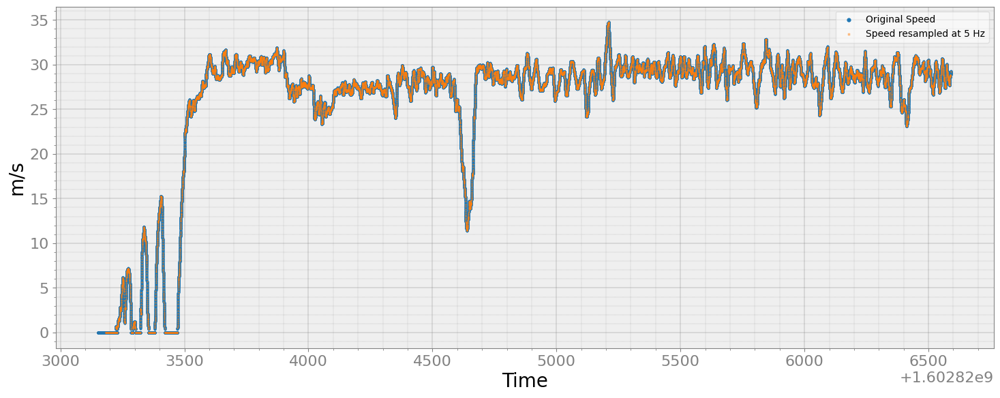

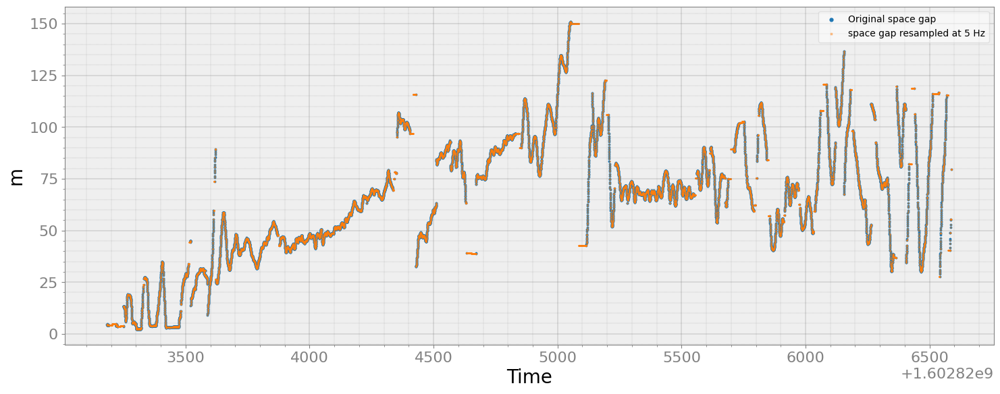

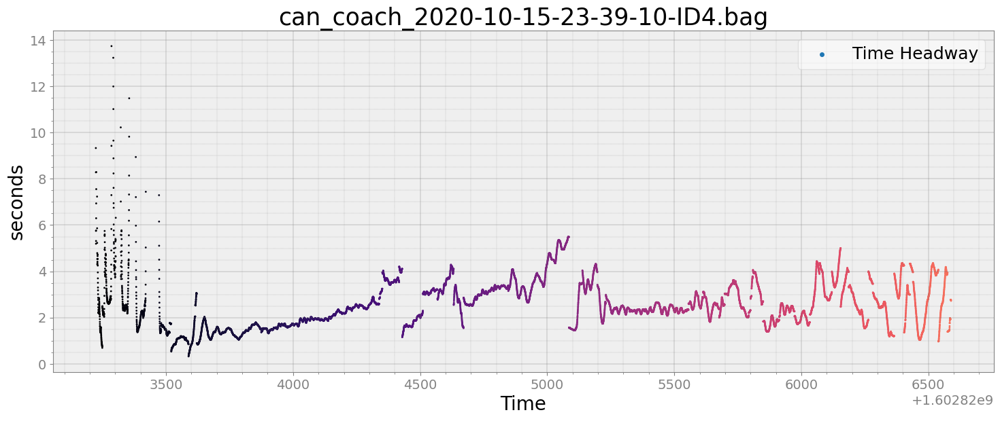

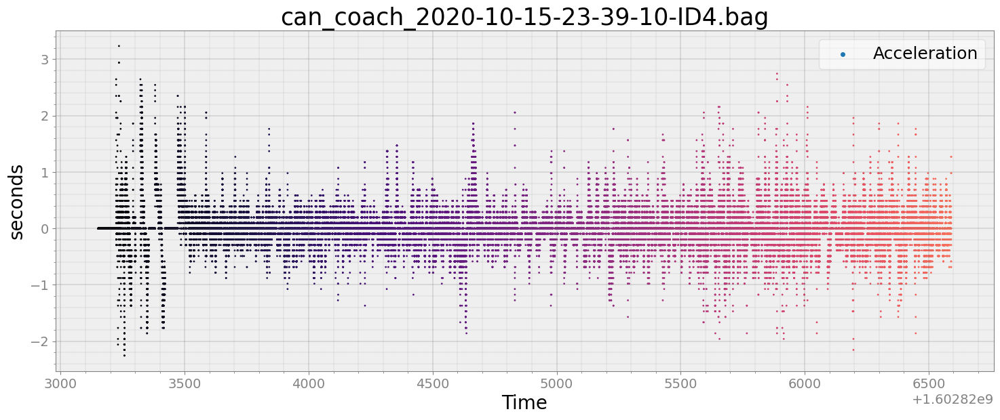

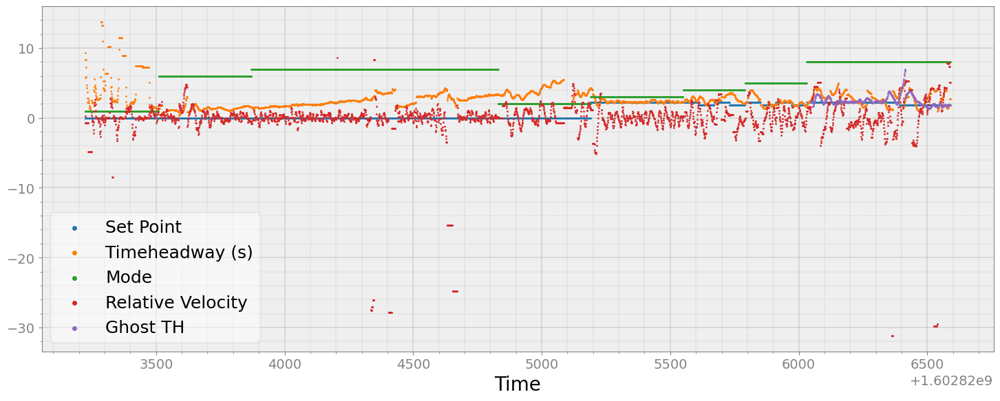

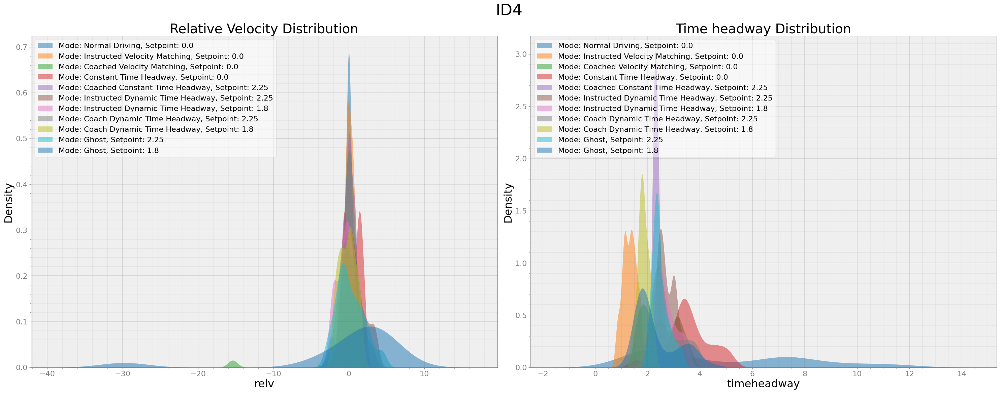

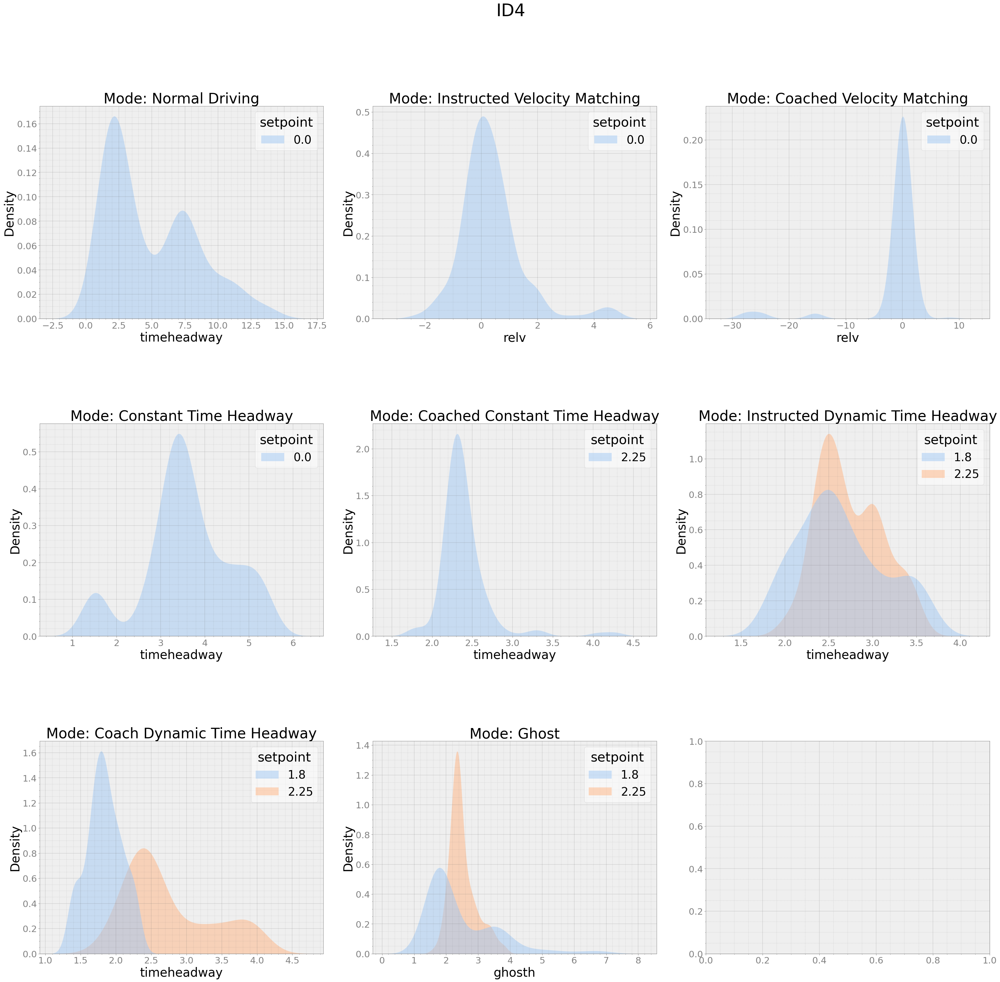

In [11]:
th_kde_plot(b3)

### Bag File with ID-5
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.205939177974905 


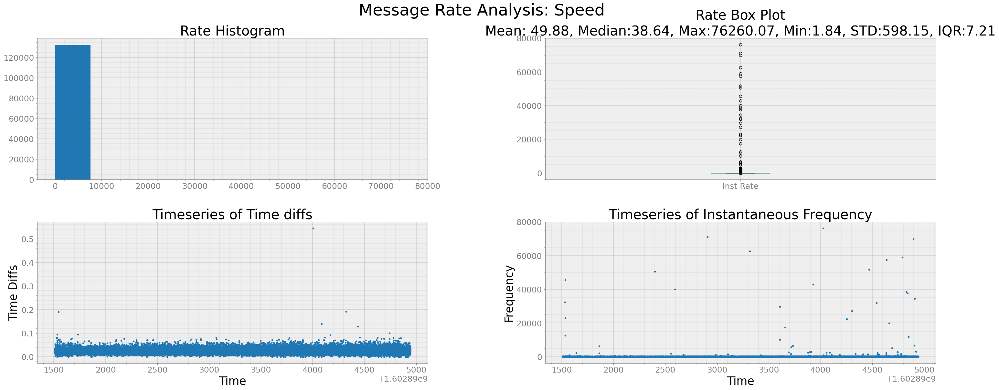

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.22491536733498574 


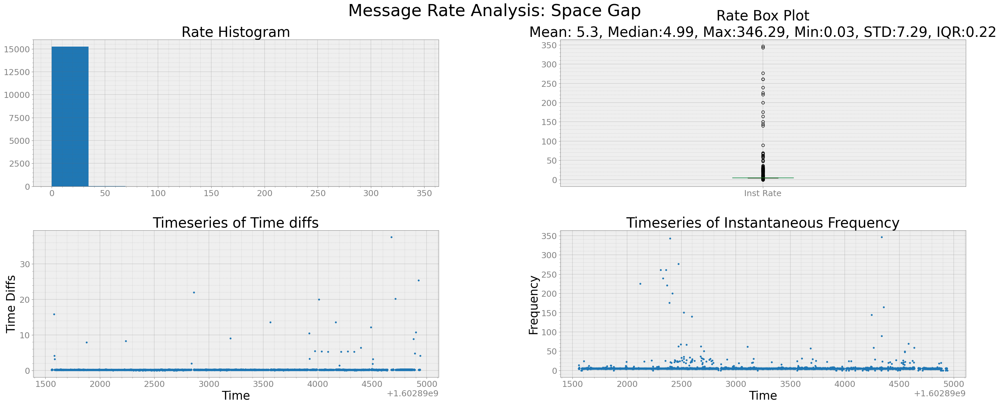

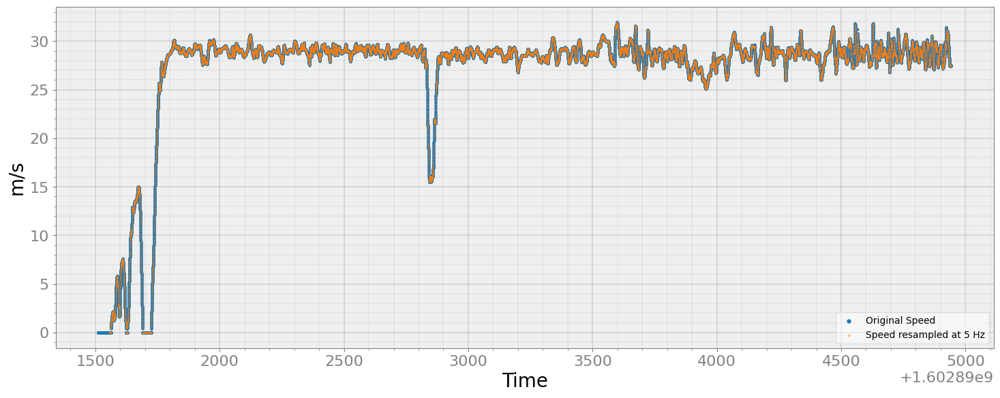

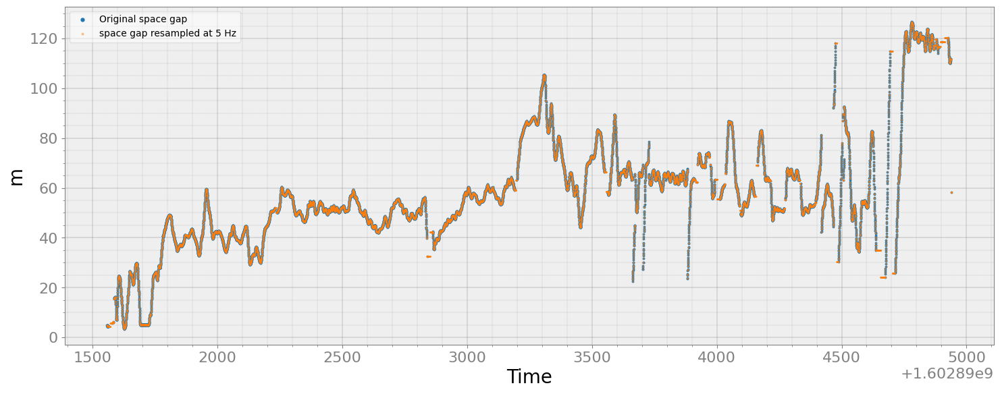

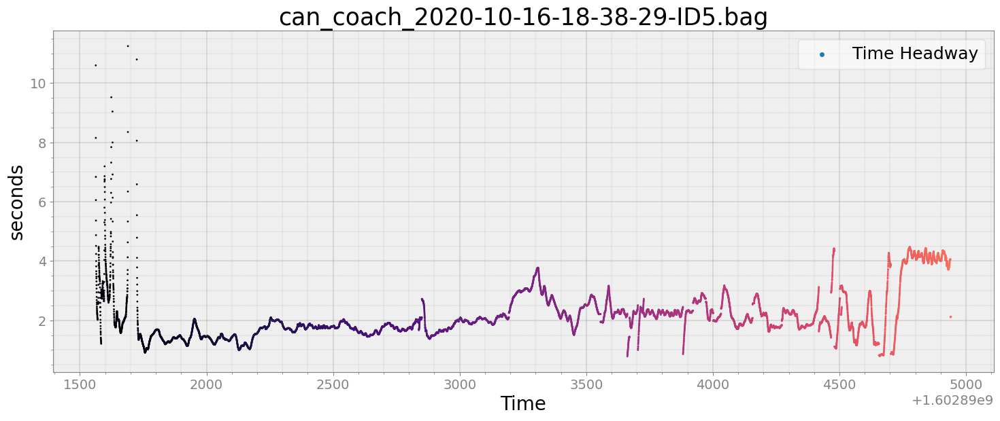

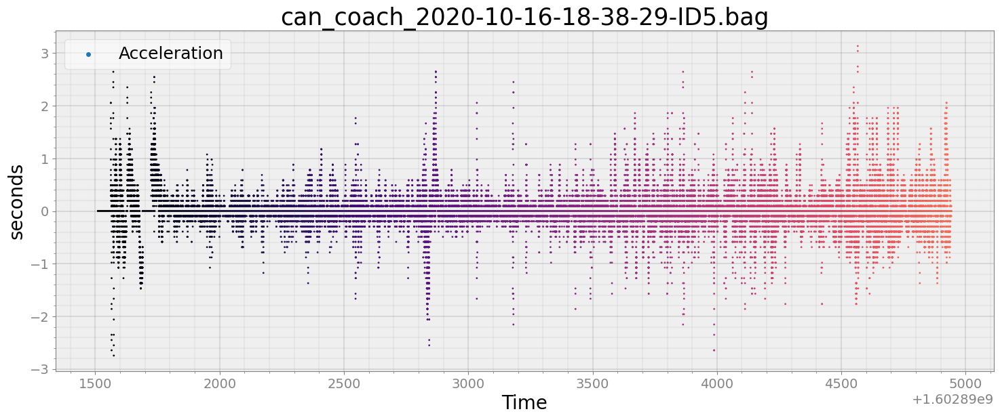

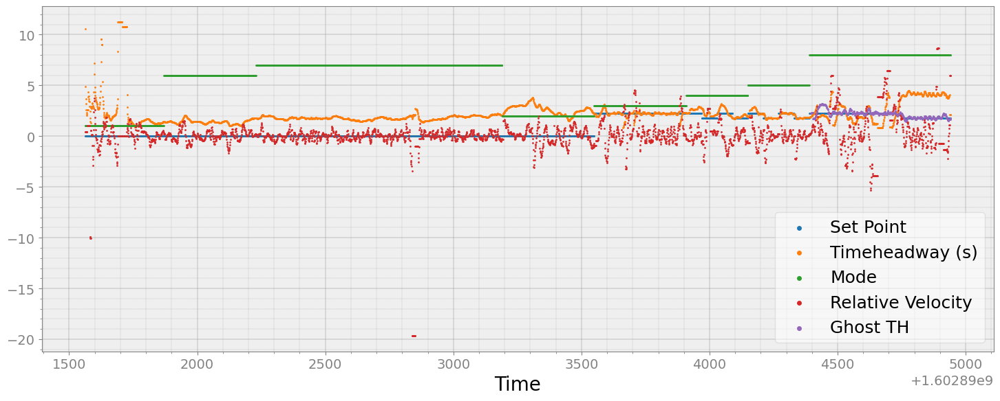

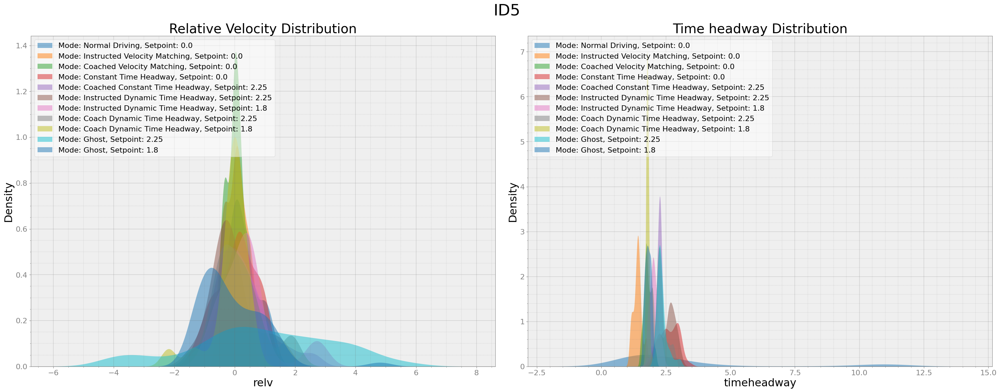

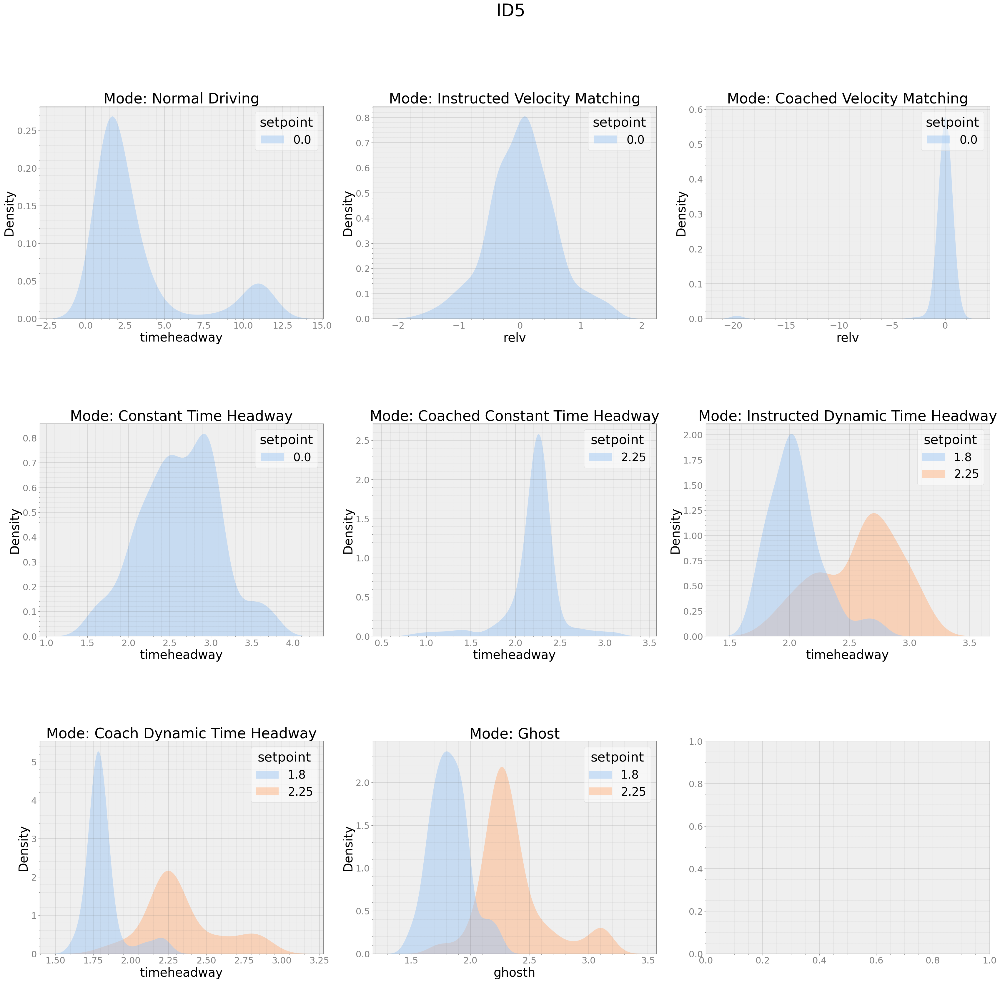

In [12]:
th_kde_plot(b4)

### Bag File with ID-6
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 9.214940913105295 


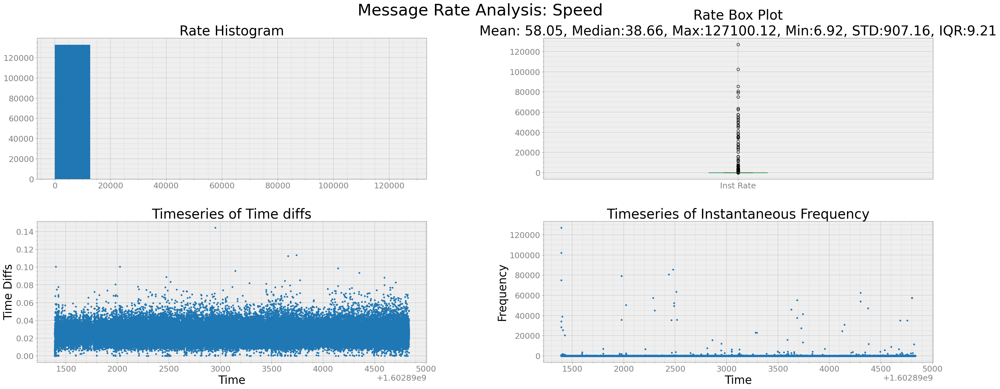

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.2826590389510901 


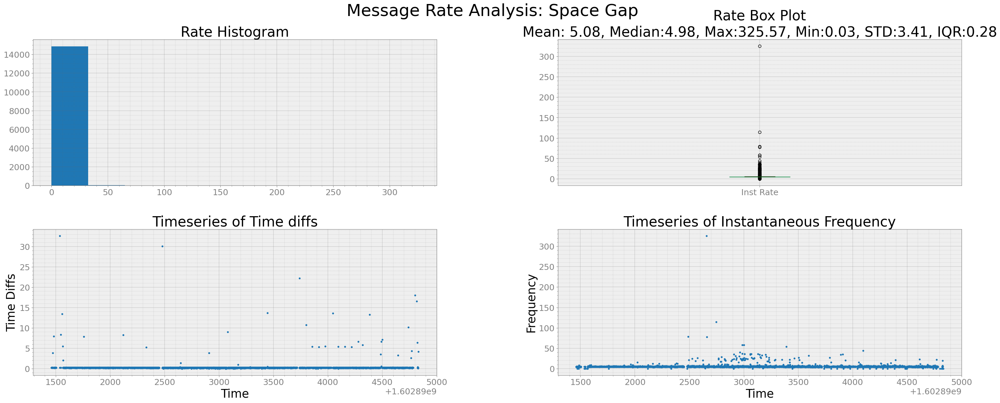

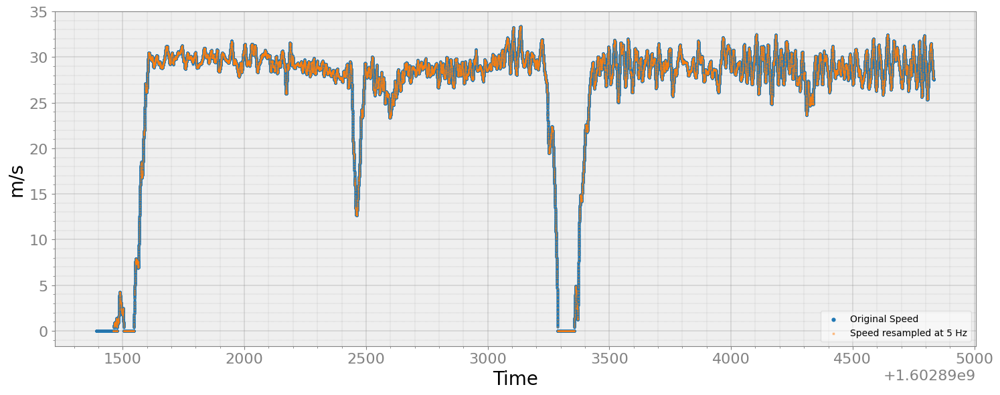

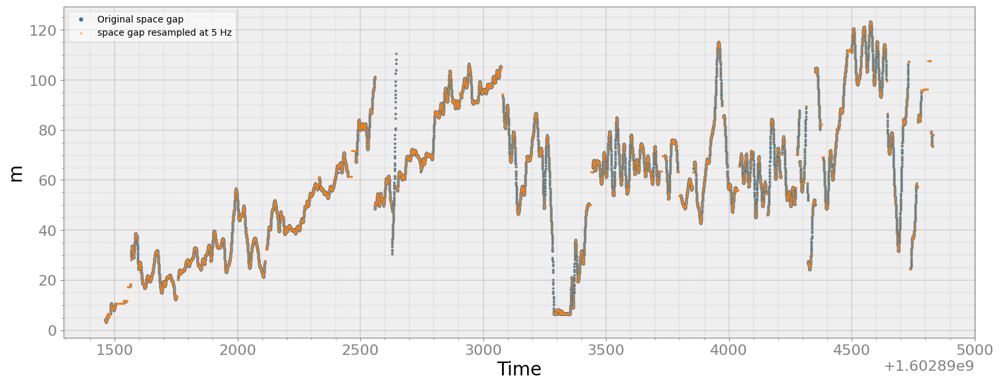

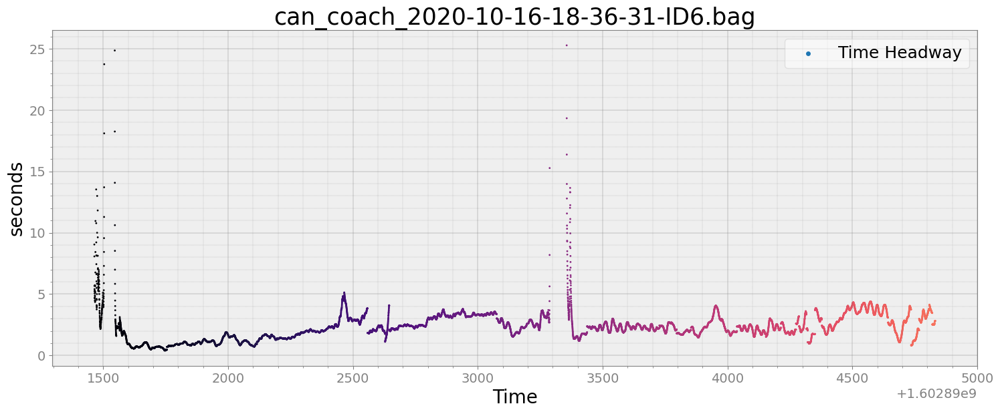

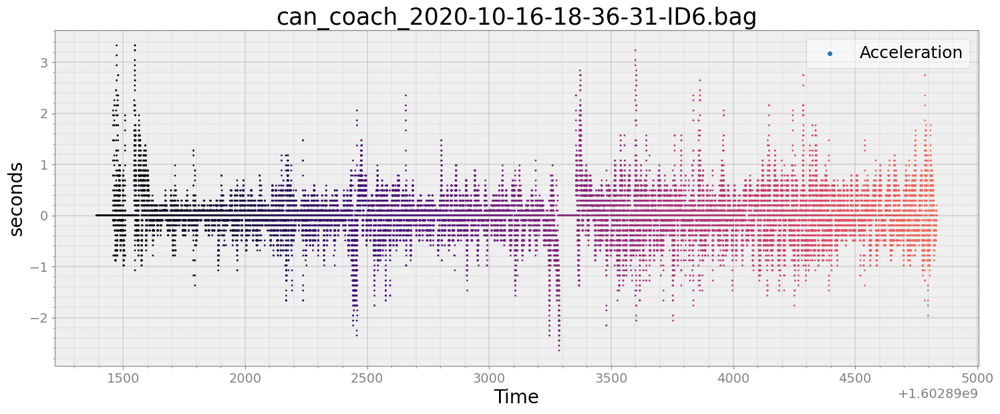

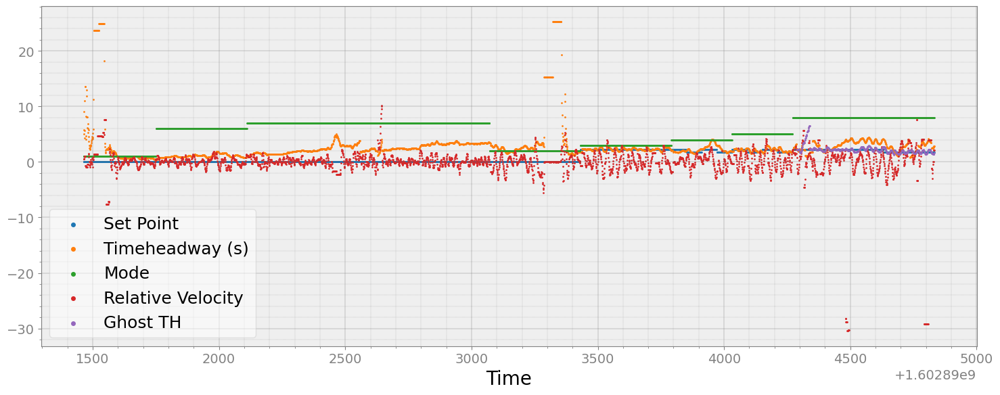

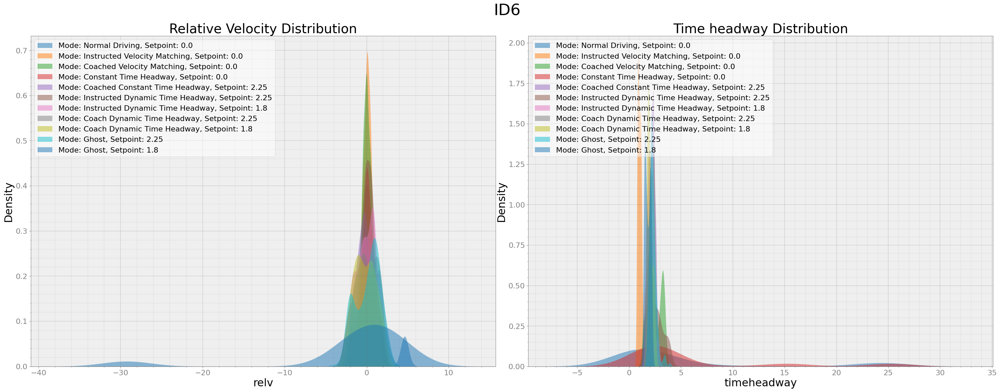

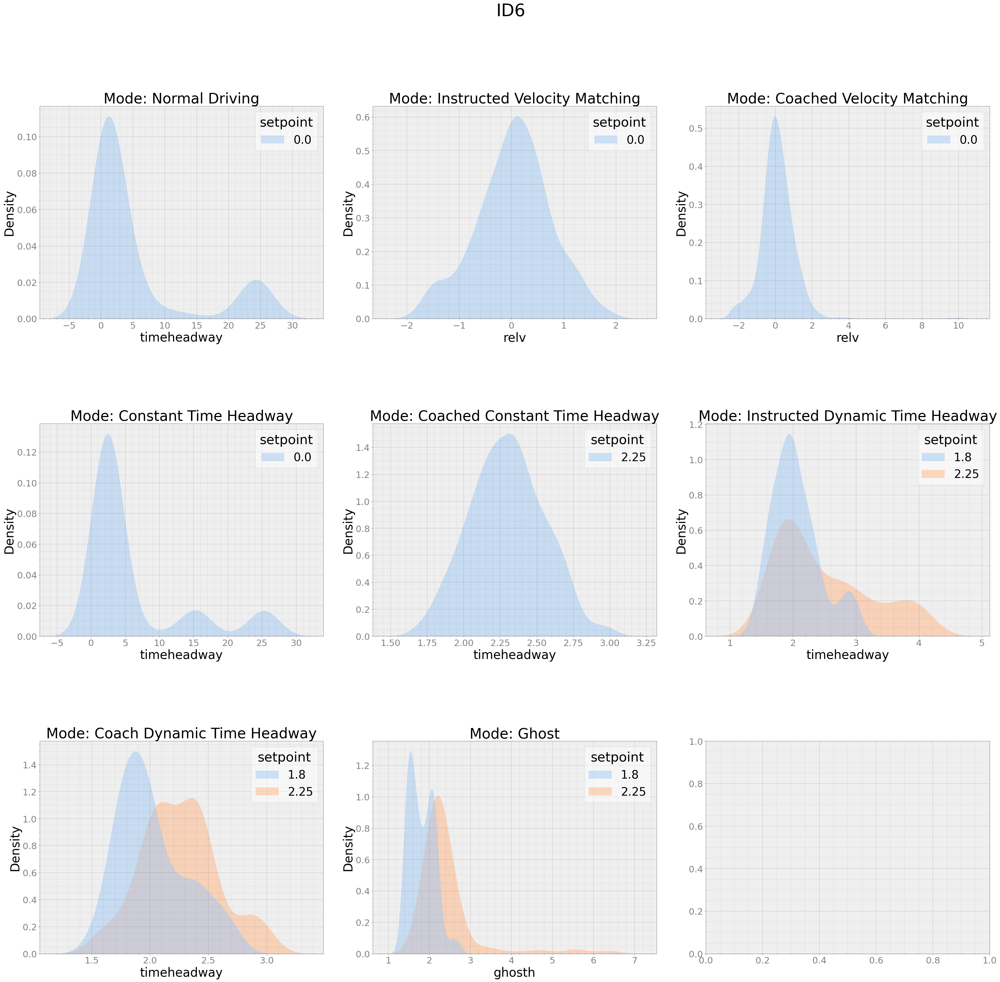

In [13]:
th_kde_plot(b5)

## Aggregated plot

ID1
(2821, 11)
ID2
(2862, 11)
ID3
(2861, 11)
ID4
(2849, 11)
ID5
(2866, 11)
ID6
(2854, 11)


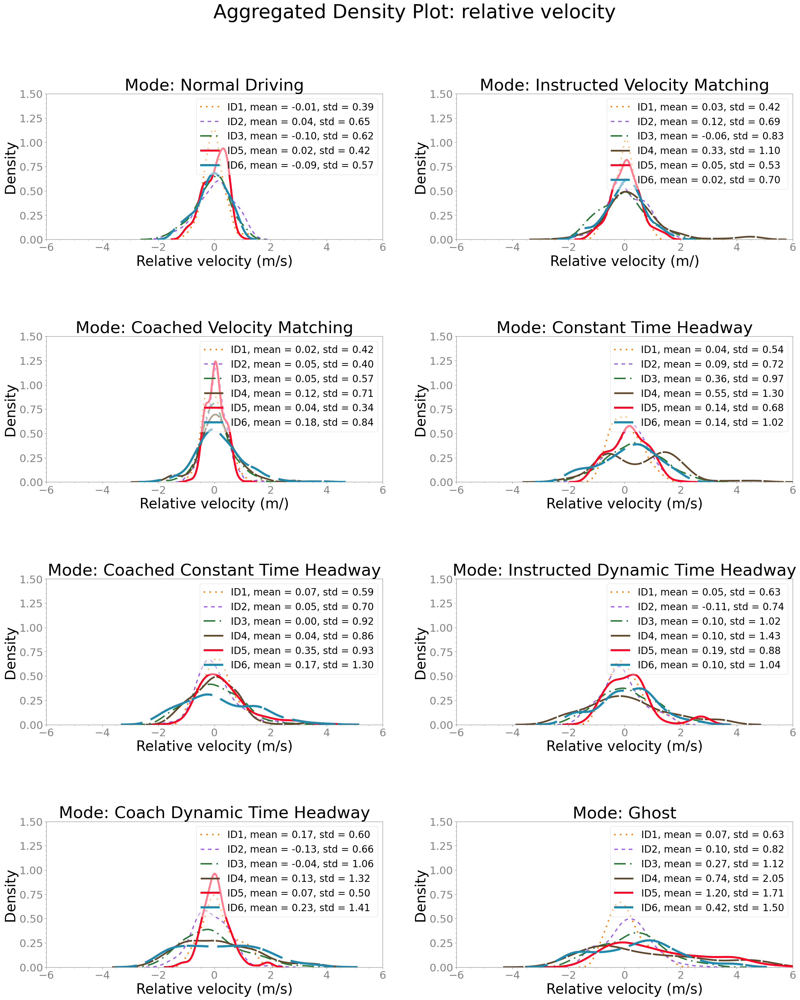

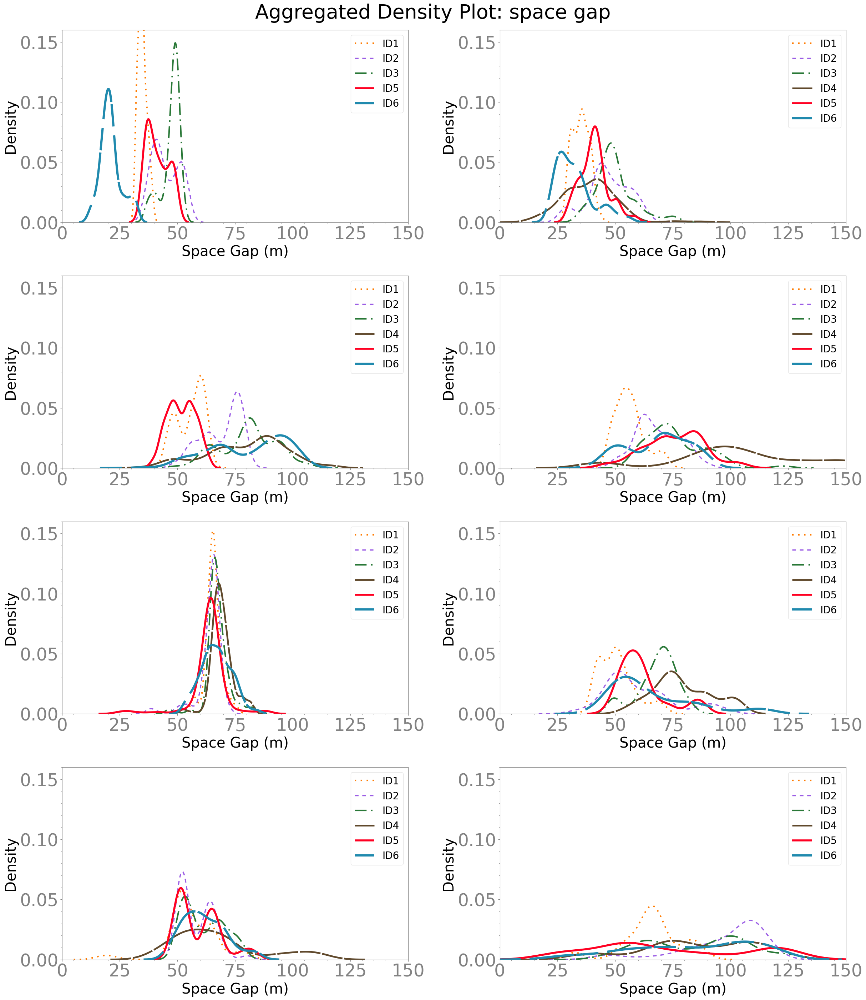

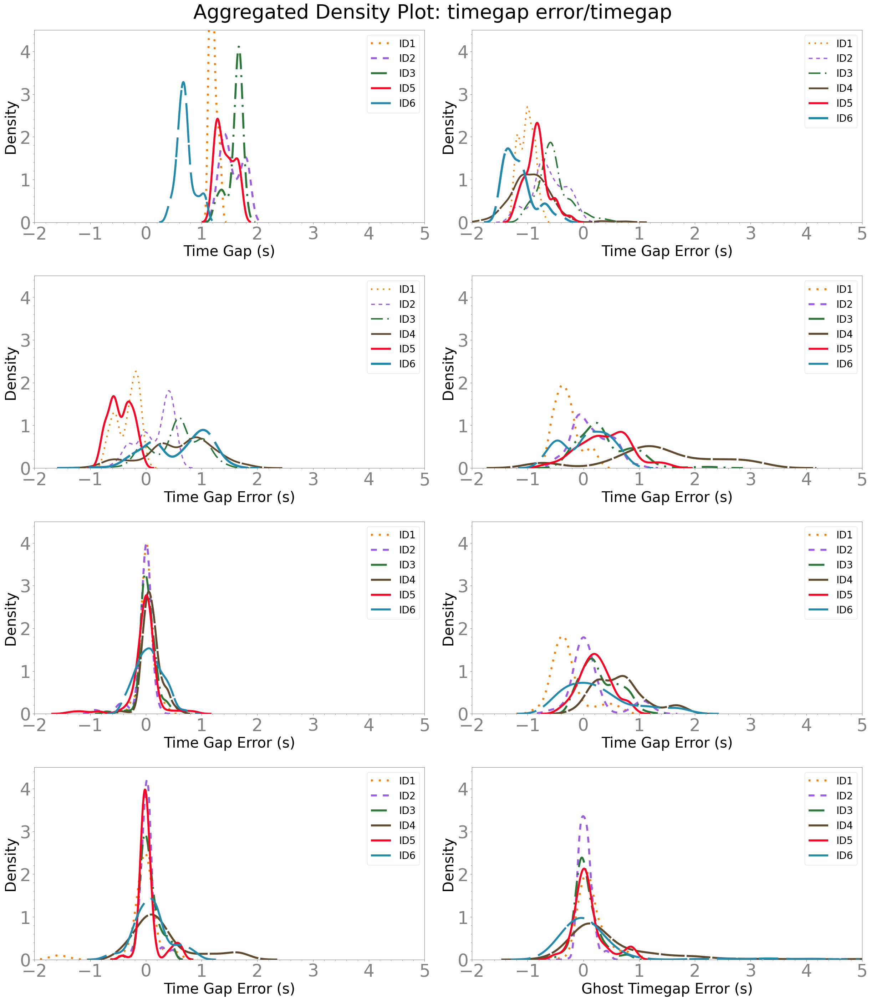

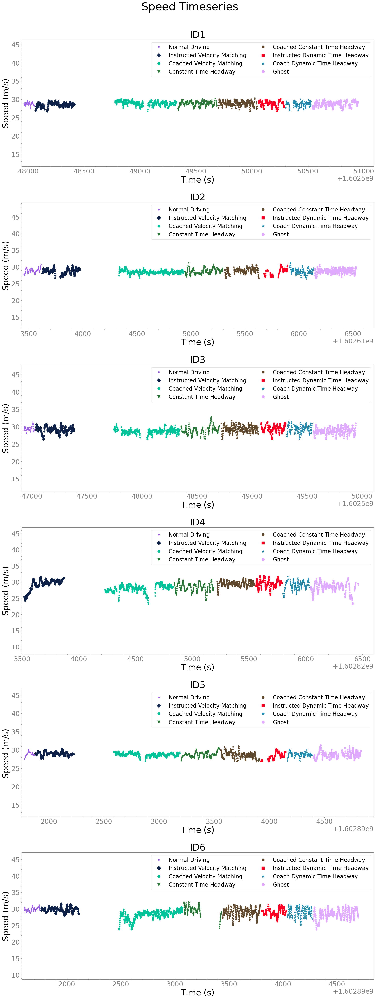

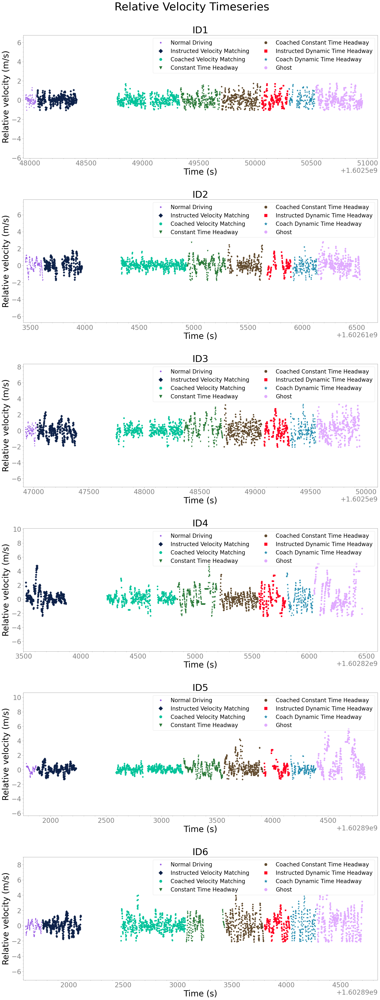

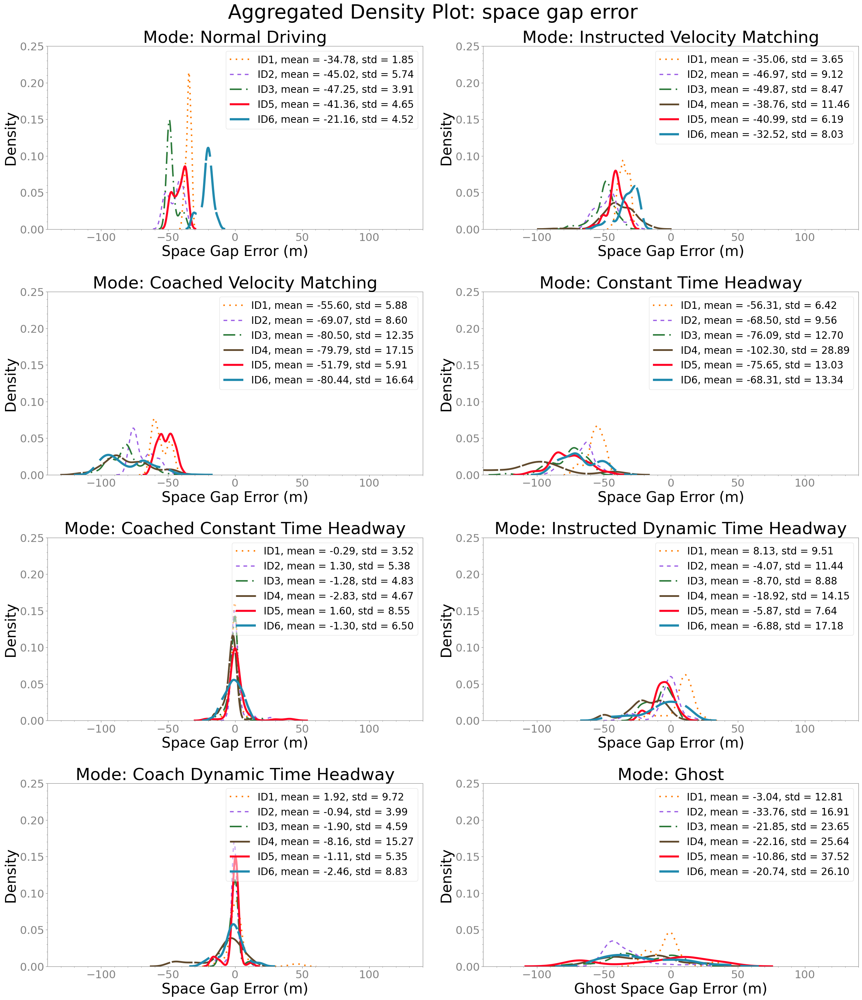

In [56]:
data = multi_bag_kde([b0, b1, b2, b3, b4, b5])

,Time,setpoint,timeheadway,mode,relv,ghosth,spacegap,speed,ghostvel,desired_spacegap,spacegap_error
Clock,,,,,,,,,,,
2020-10-13 00:35:29.209904671,1.602549e+09,0.0,1.986377,2.0,-0.600,NaN,58.080389,29.360001,NaN,0.0,-58.080389
2020-10-13 00:35:30.210292101,1.602549e+09,0.0,1.981590,2.0,-0.600,NaN,58.080389,29.309999,NaN,0.0,-58.080389
2020-10-13 00:35:31.210679770,1.602549e+09,0.0,1.982266,2.0,-0.600,NaN,58.080389,29.299999,NaN,0.0,-58.080389
2020-10-13 00:35:32.211067200,1.602549e+09,0.0,1.980914,2.0,-0.600,NaN,58.080389,29.309999,NaN,0.0,-58.080389
2020-10-13 00:35:33.211454630,1.602549e+09,0.0,2.004846,2.0,-0.600,NaN,58.080389,28.910000,NaN,0.0,-58.080389
2020-10-13 00:35:34.211842299,1.602549e+09,0.0,1.965855,2.0,0.600,NaN,56.164487,28.520000,NaN,0.0,-56.164487
2020-10-13 00:35:35.212229729,1.602549e+09,0.0,1.983209,2.0,0.600,NaN,56.164487,28.299999,NaN,0.0,-56.164487
2020-10-13 00:35:36.212617159,1.602549e+09,0.0,1.997315,2.0,0.600,NaN,56.164487,28.070000,NaN,0.0,-56.164487
2020-10-13 00:35:37.213004827,1.602549e+09,0.0,2.006591,2.0,0.600,NaN,56.164487,27.990000,NaN,0.0,-56.164487


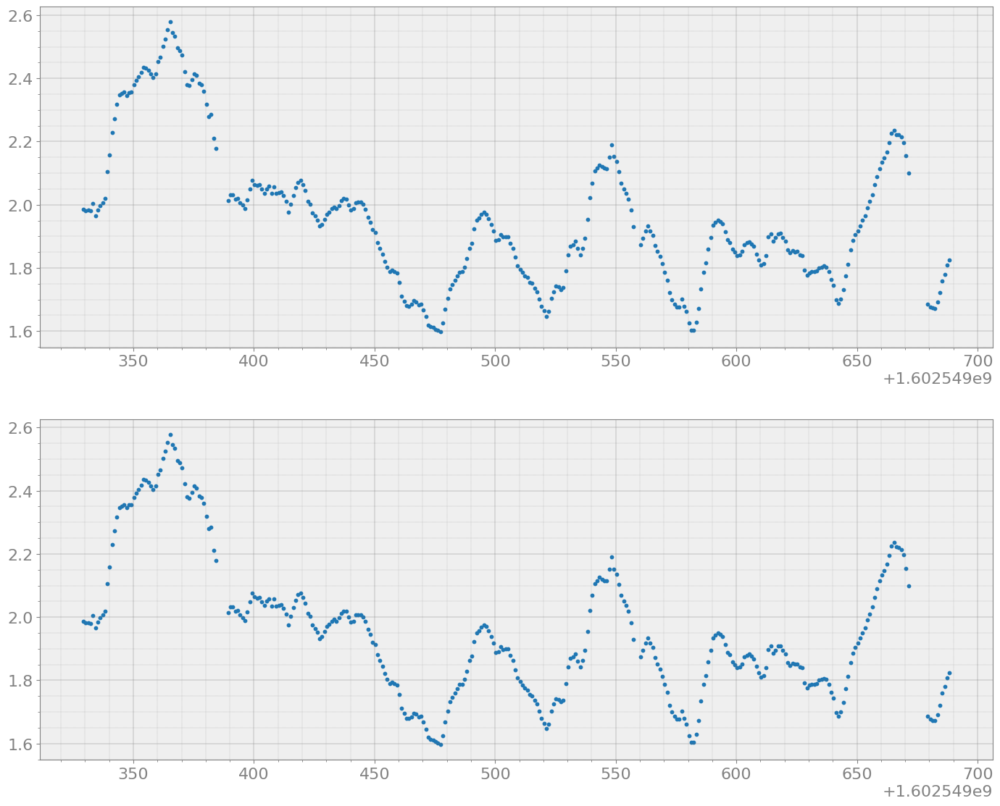

In [29]:
data_2 = data[data['mode'] == 2]
fig, ax = bagpy.create_fig(2)
ax[0].scatter( x = data_2['Time'], y = data_2['timeheadway'], s= 10)
ax[1].scatter( x = data_2['Time'], y = data_2['timeheadway'] - data_2['setpoint'], s= 10)
data_2

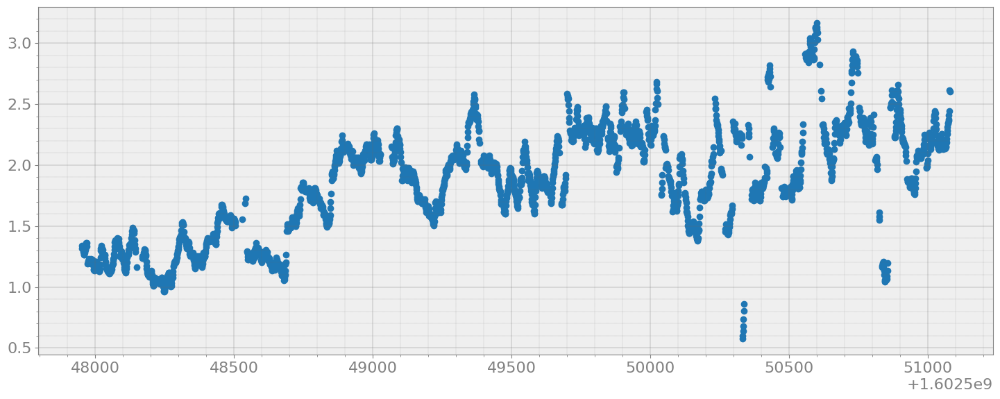

In [13]:
data = multi_bag_kde([b1])
fig, ax = bagpy.create_fig(1)
ax[0].scatter( x = data['Time'], y = data['timeheadway'], s= 1)

ID3
(2861, 11)
ID: ID3, Mode: 1
Clock
2020-10-12 23:55:27.463192463    1.787978
2020-10-12 23:55:28.463623524    1.794924
2020-10-12 23:55:29.464054585    1.796057
2020-10-12 23:55:30.464485645    1.793388
2020-10-12 23:55:31.464916706    1.784908
                                   ...   
2020-10-12 23:57:01.503707170    1.367846
2020-10-12 23:57:02.504138231    1.383663
2020-10-12 23:57:03.504569292    1.398219
2020-10-12 23:57:04.505000114    1.408062
2020-10-12 23:57:05.505431175    1.424375
Length: 99, dtype: float64
ID:2, mode: 1, mean: -47.24891390869671, stddev: 3.9126624576770523
ID:2, mode: 6, mean: -49.87305269839291, stddev: 8.473763660920651
ID:2, mode: 7, mean: -80.4958369035363, stddev: 12.348526729602169
ID: ID3, Mode: 2
Clock
2020-10-13 00:19:16.078669548    2.104625
2020-10-13 00:19:17.079100609    2.110151
2020-10-13 00:19:18.079531670    2.068297
2020-10-13 00:19:19.079962730    2.032581
2020-10-13 00:19:20.080393553    1.994666
                                   ...

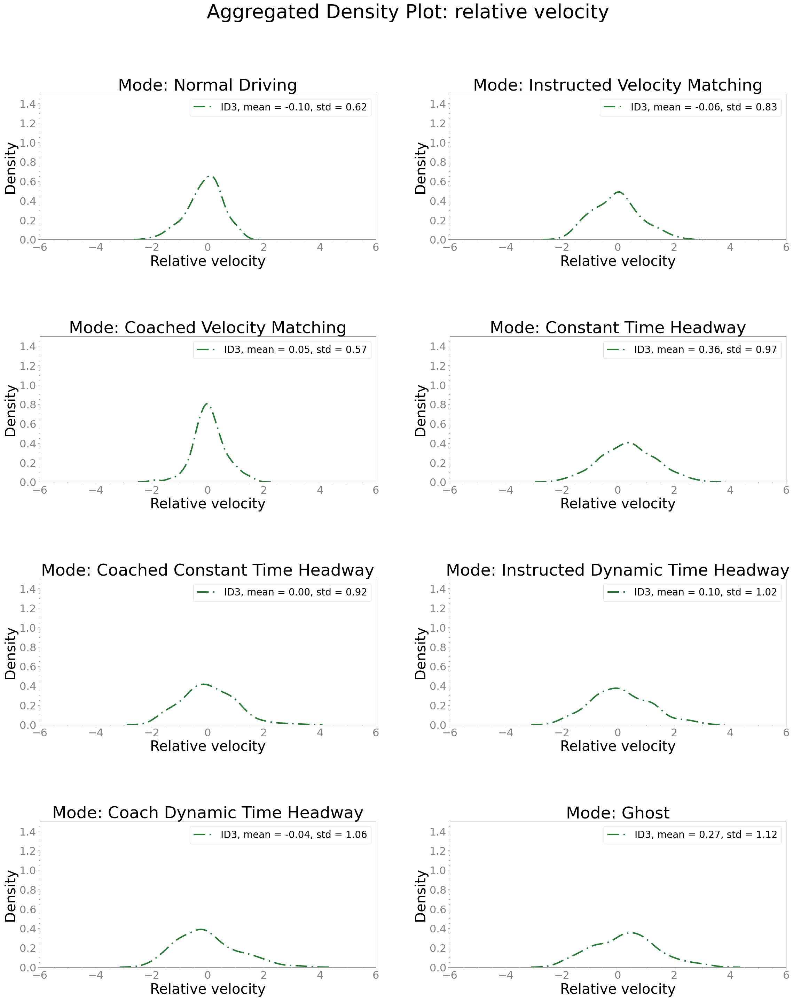

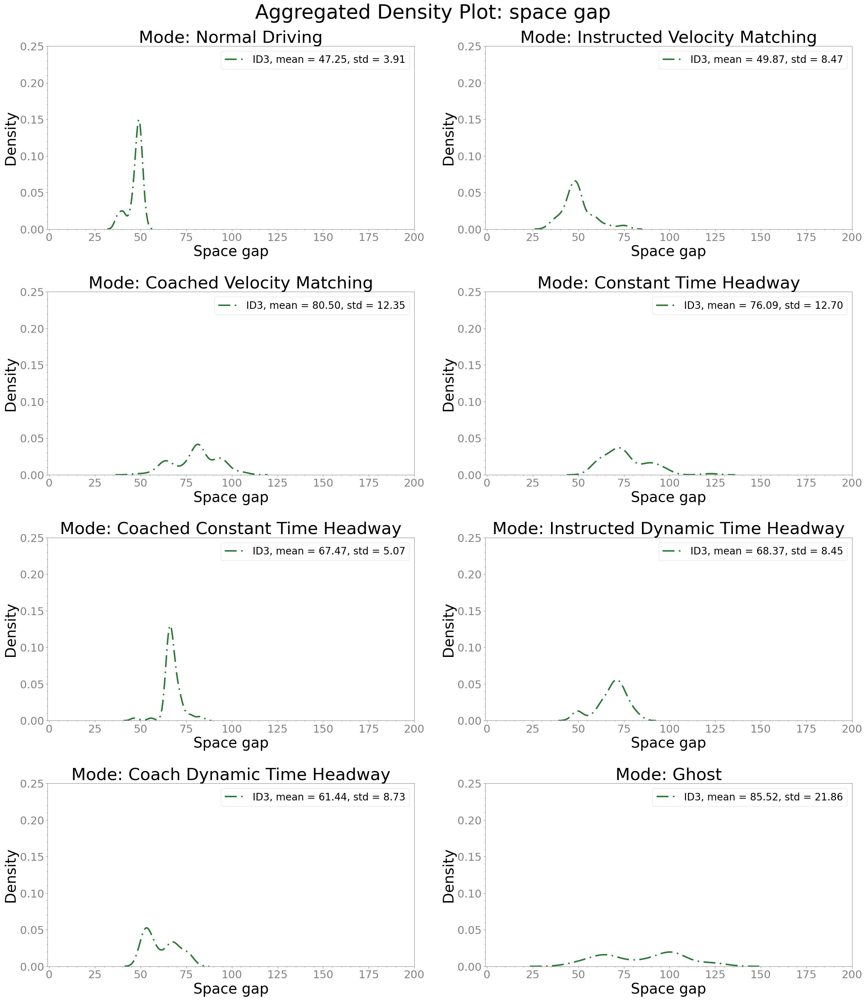

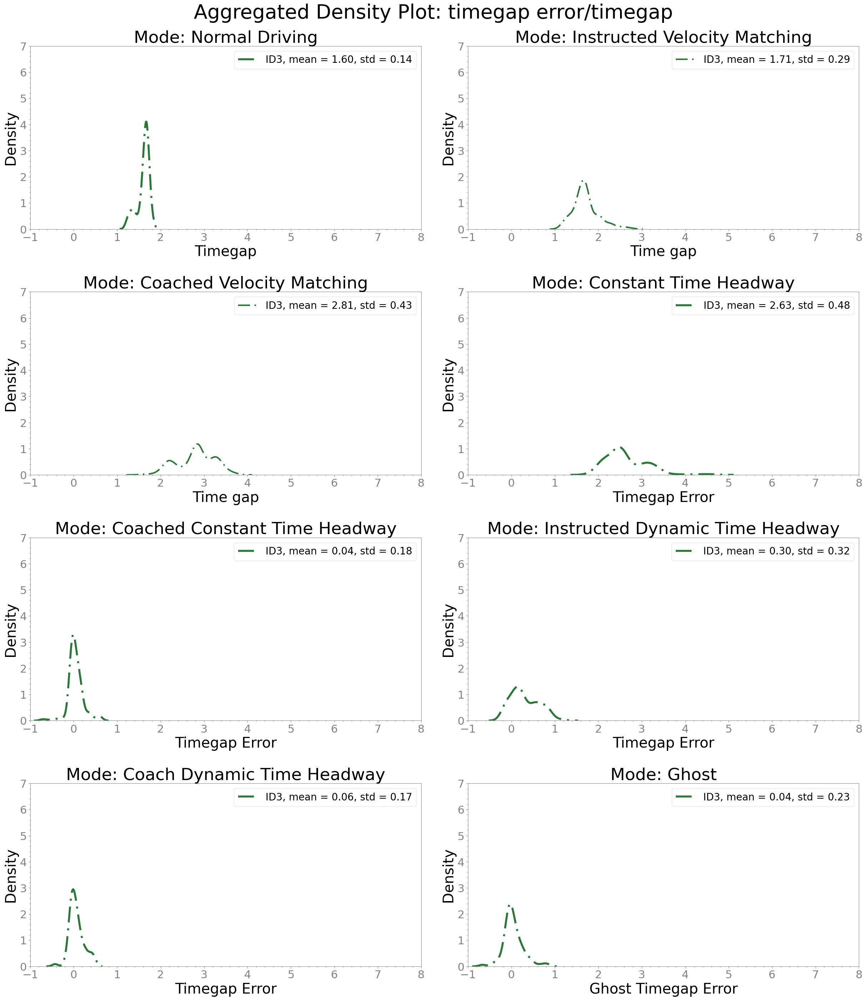

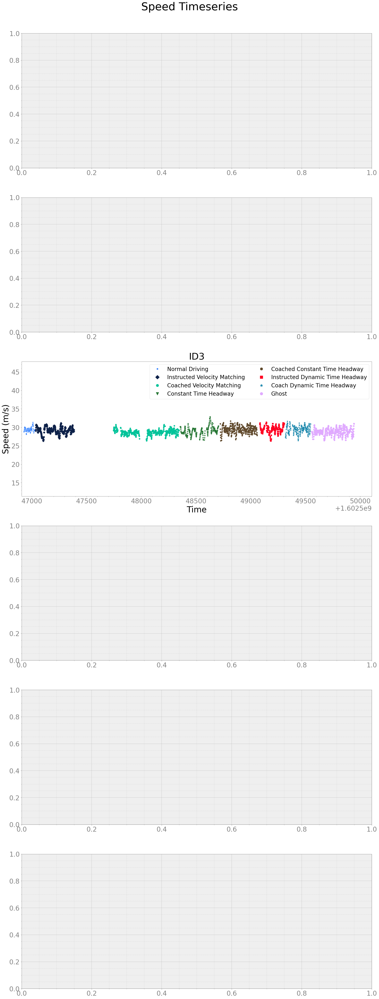

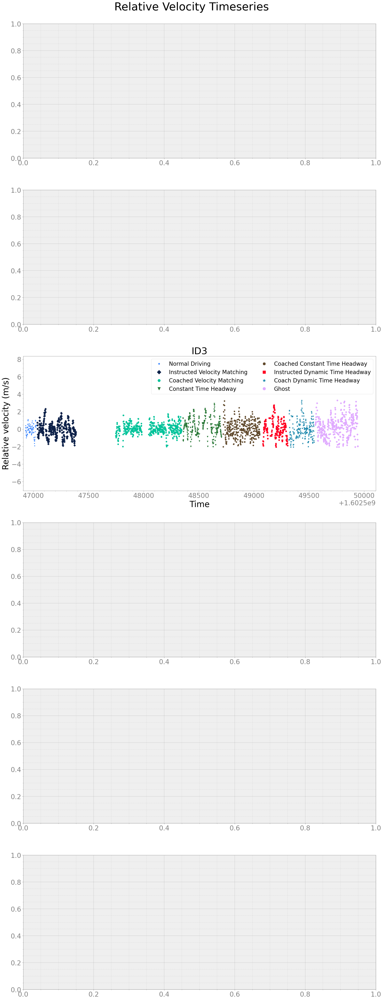

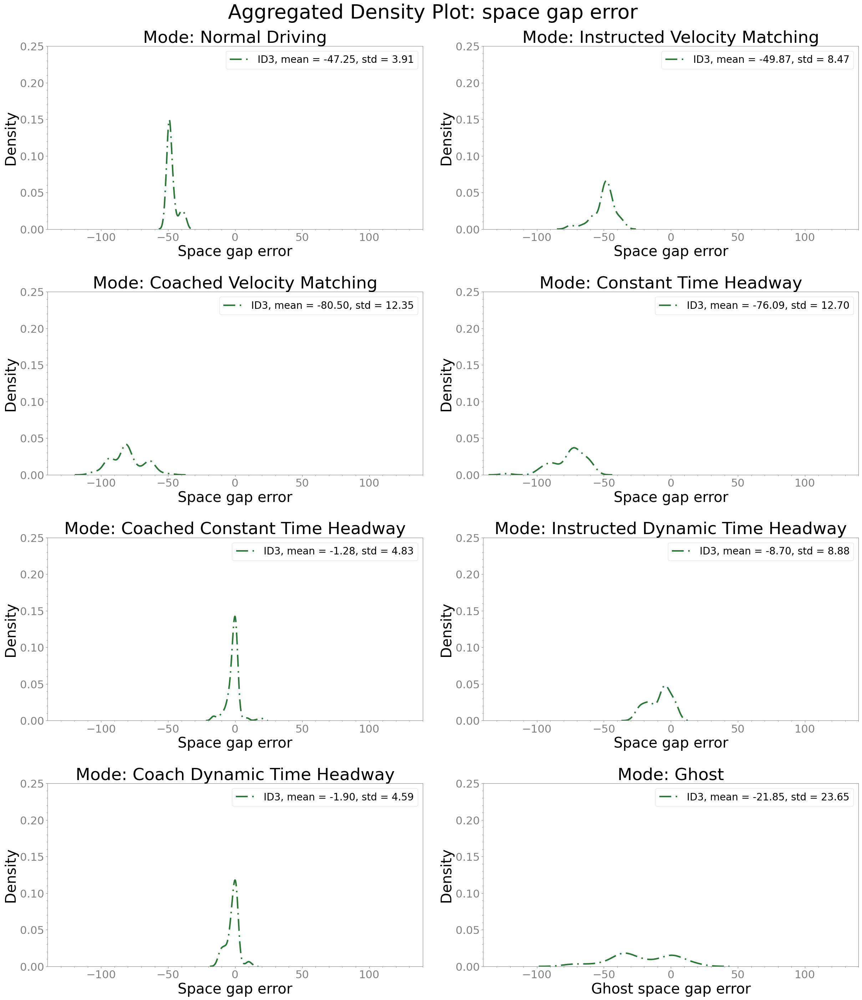

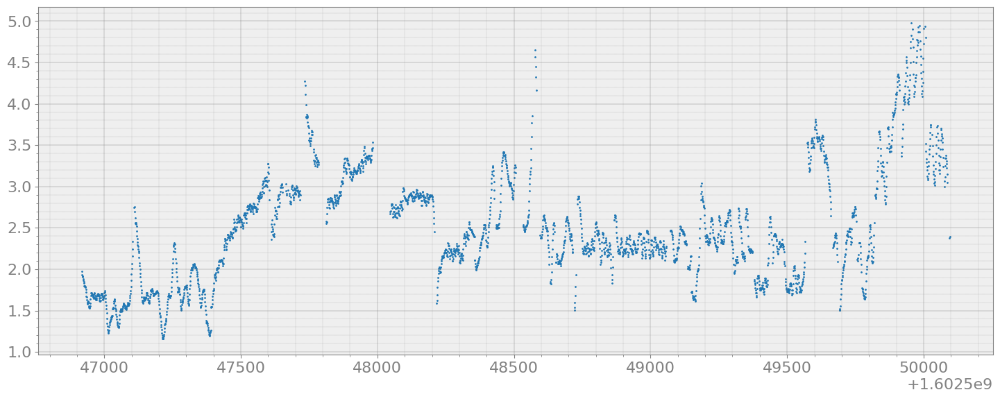

In [15]:
data = multi_bag_kde([b2])
fig, ax = bagpy.create_fig(1)
ax[0].scatter( x = data['Time'], y = data['timeheadway'], s= 1)

ID4
(2849, 11)
ID: ID4, Mode: 1
Series([], dtype: float64)
ID:3, mode: 1, mean: nan, stddev: nan


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


ID:3, mode: 6, mean: -38.762194796045534, stddev: 11.46345857919713
ID:3, mode: 7, mean: -79.79397612751478, stddev: 17.14881689164982
ID: ID4, Mode: 2
Clock
2020-10-16 05:07:21.466408253    3.242806
2020-10-16 05:07:22.466849566    3.253688
2020-10-16 05:07:23.467290640    3.286776
2020-10-16 05:07:24.467731714    3.322820
2020-10-16 05:07:25.468172789    3.358500
                                   ...   
2020-10-16 05:13:05.618149996    4.129243
2020-10-16 05:13:06.618591070    4.178748
2020-10-16 05:13:07.619032145    4.218888
2020-10-16 05:13:08.619473219    4.243881
2020-10-16 05:13:09.619914532    4.288529
Length: 338, dtype: float64
ID:3, mode: 2, mean: -102.30030203459968, stddev: 28.888957672439442
ID: ID4, Mode: 3
Clock
2020-10-16 05:13:38.632706642   -0.514042
2020-10-16 05:13:39.633147717   -0.481004
2020-10-16 05:13:40.633588791   -0.434602
2020-10-16 05:13:41.634029865   -0.381818
2020-10-16 05:13:42.634470940   -0.310762
                                   ...   
2020-10-

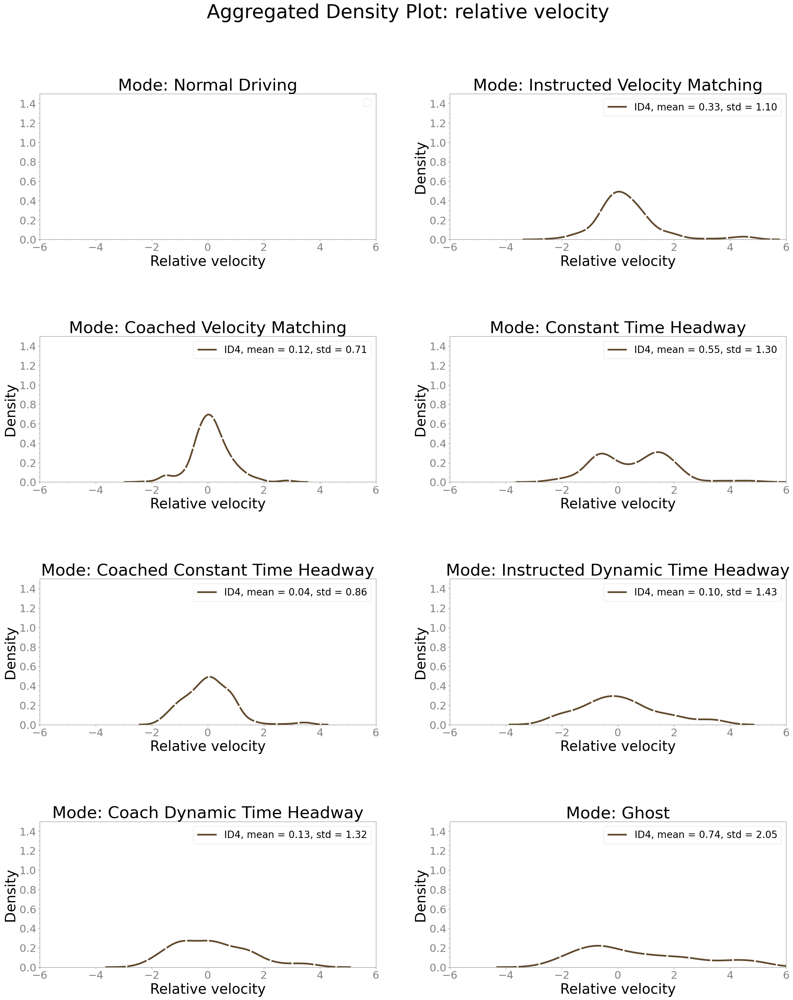

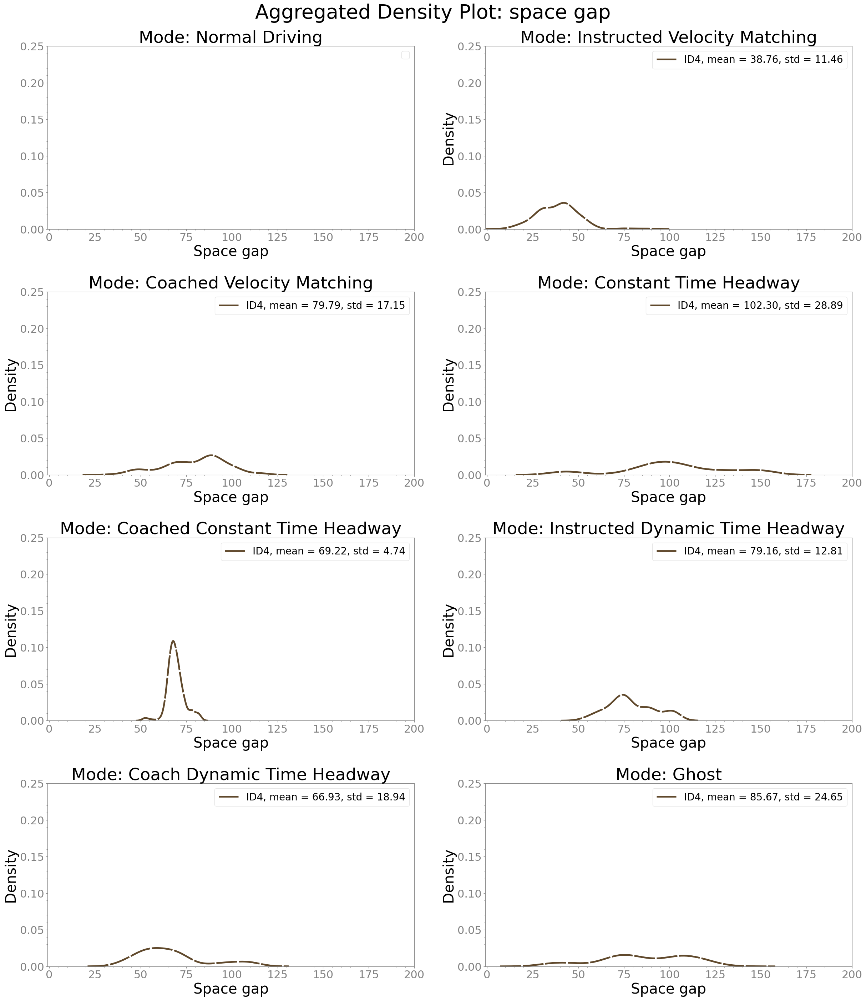

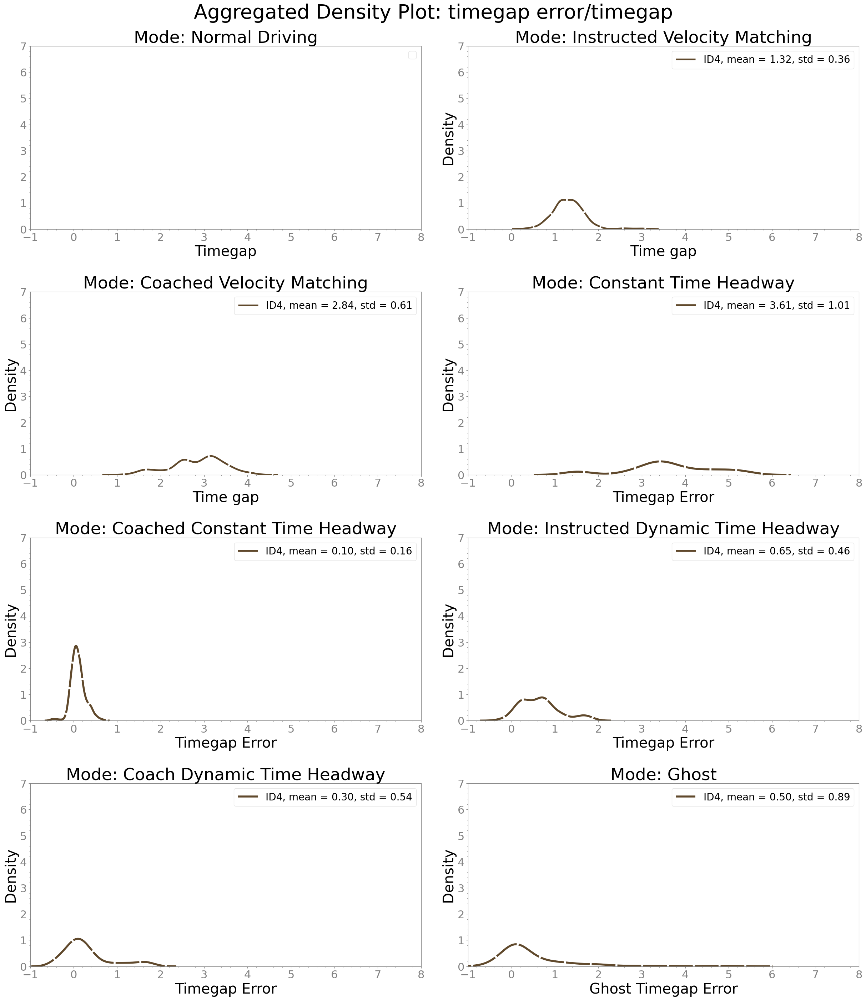

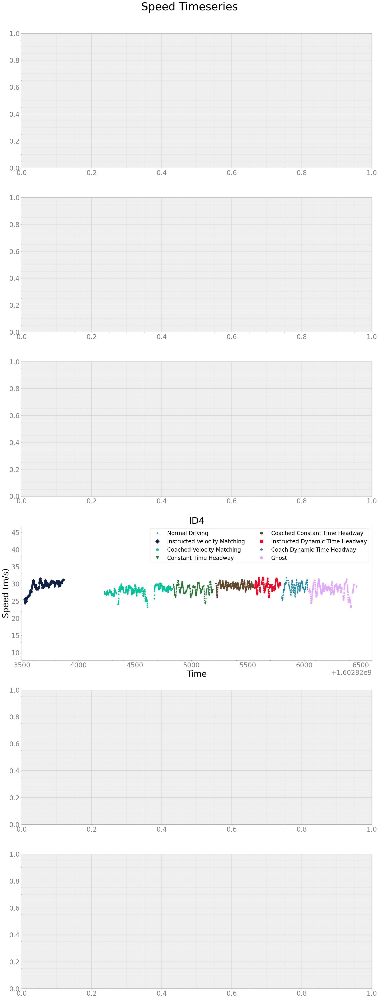

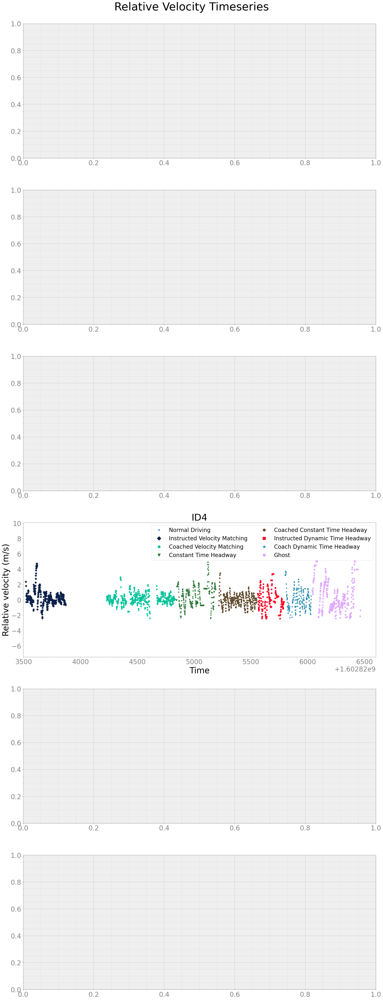

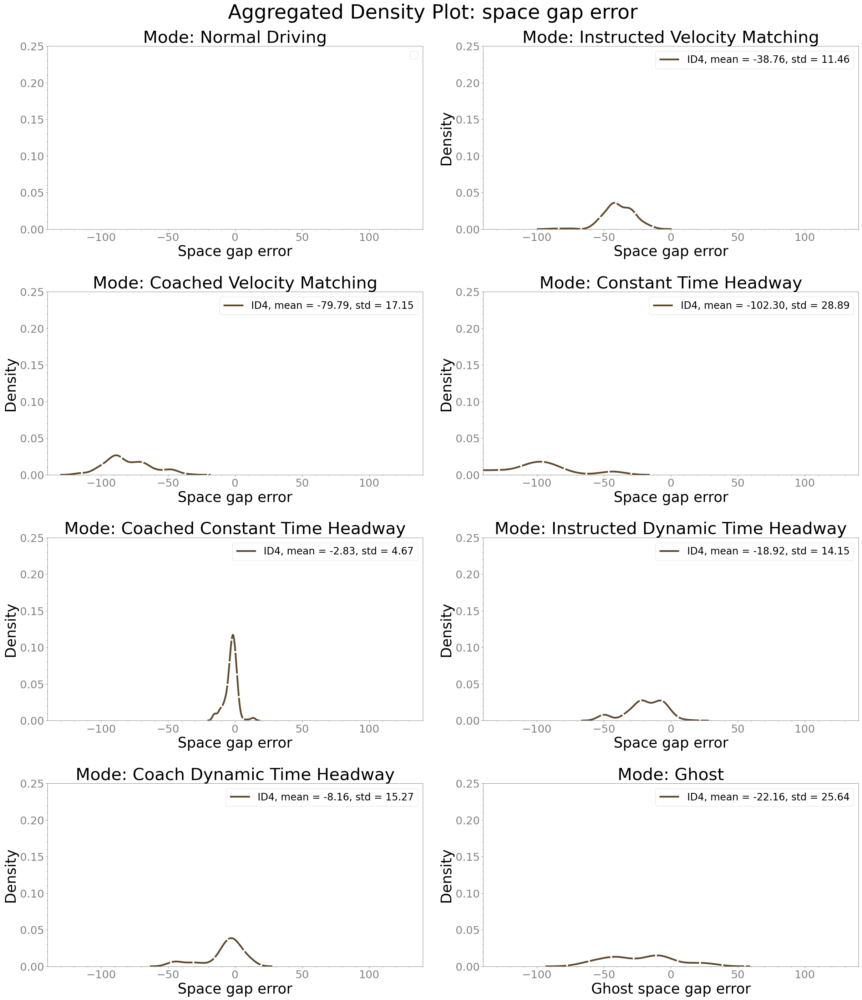

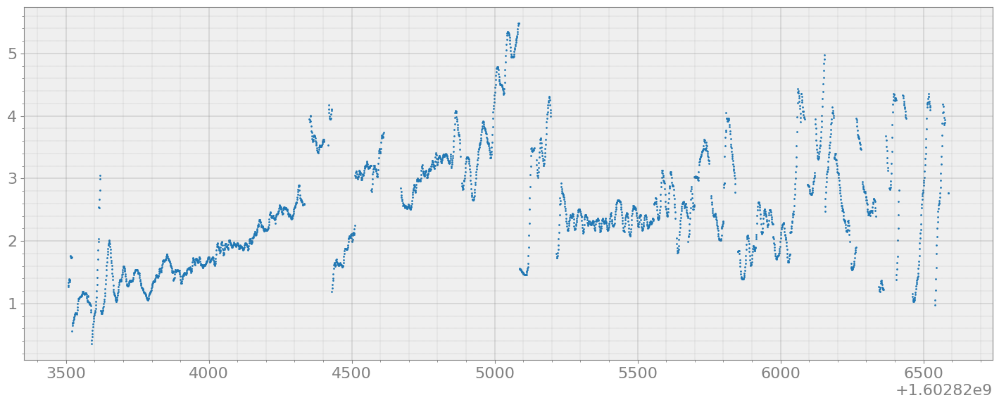

In [17]:
data = multi_bag_kde([b3])
fig, ax = bagpy.create_fig(1)
ax[0].scatter( x = data['Time'], y = data['timeheadway'], s= 1)

ID5
(2866, 11)
ID: ID5, Mode: 1
Clock
2020-10-16 23:43:00.816862106    1.447789
2020-10-16 23:43:01.817379236    1.458771
2020-10-16 23:43:02.817896366    1.477848
2020-10-16 23:43:03.818413496    1.484400
2020-10-16 23:43:04.818930864    1.499997
                                   ...   
2020-10-16 23:44:24.860302925    1.364239
2020-10-16 23:44:25.860820055    1.388550
2020-10-16 23:44:26.861337423    1.400138
2020-10-16 23:44:27.861854553    1.419397
2020-10-16 23:44:28.862371683    1.422214
Length: 89, dtype: float64
ID:4, mode: 1, mean: -41.360003205722194, stddev: 4.648721406970578
ID:4, mode: 6, mean: -40.99235958165287, stddev: 6.186053456991518
ID:4, mode: 7, mean: -51.79079778390085, stddev: 5.910049819023272
ID: ID5, Mode: 2
Clock
2020-10-17 00:06:40.550702333    2.466994
2020-10-17 00:06:41.551219463    2.491711
2020-10-17 00:06:42.551736593    2.524078
2020-10-17 00:06:43.552253723    2.554421
2020-10-17 00:06:44.552770853    2.556872
                                   ...

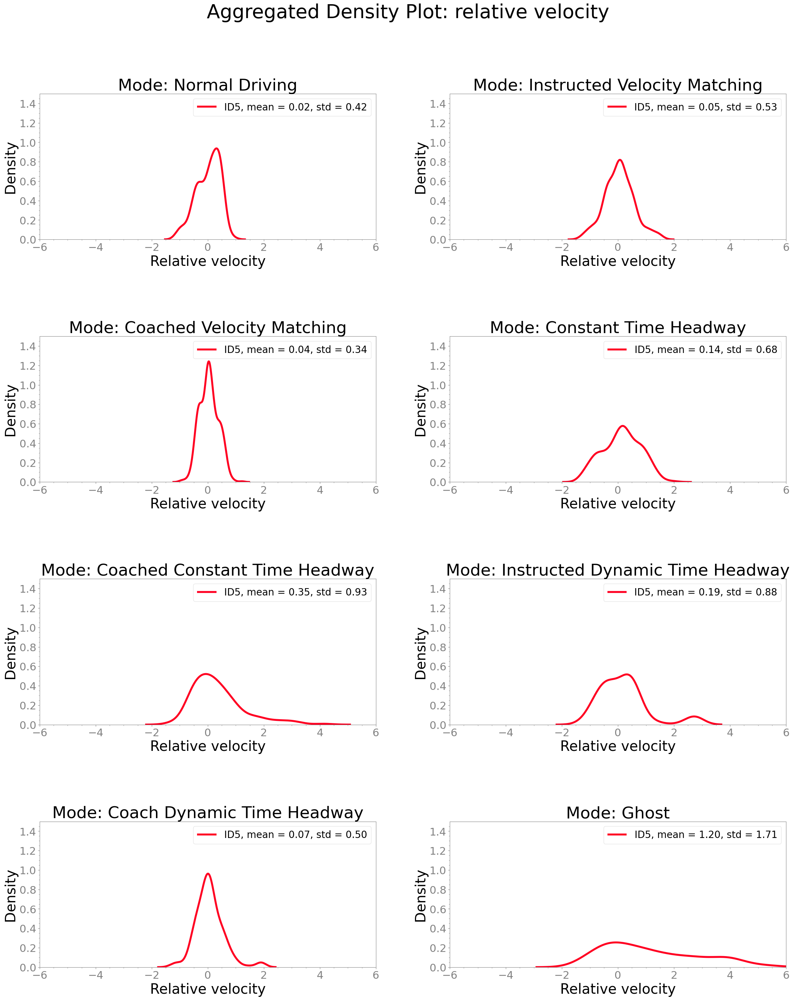

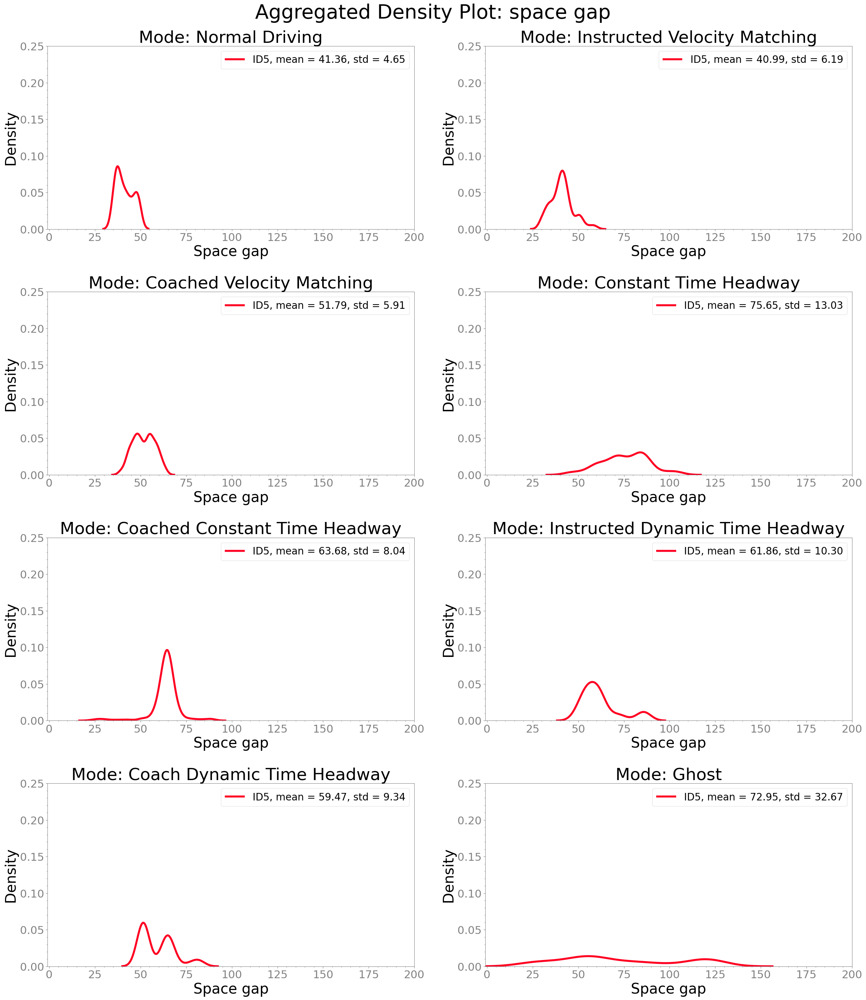

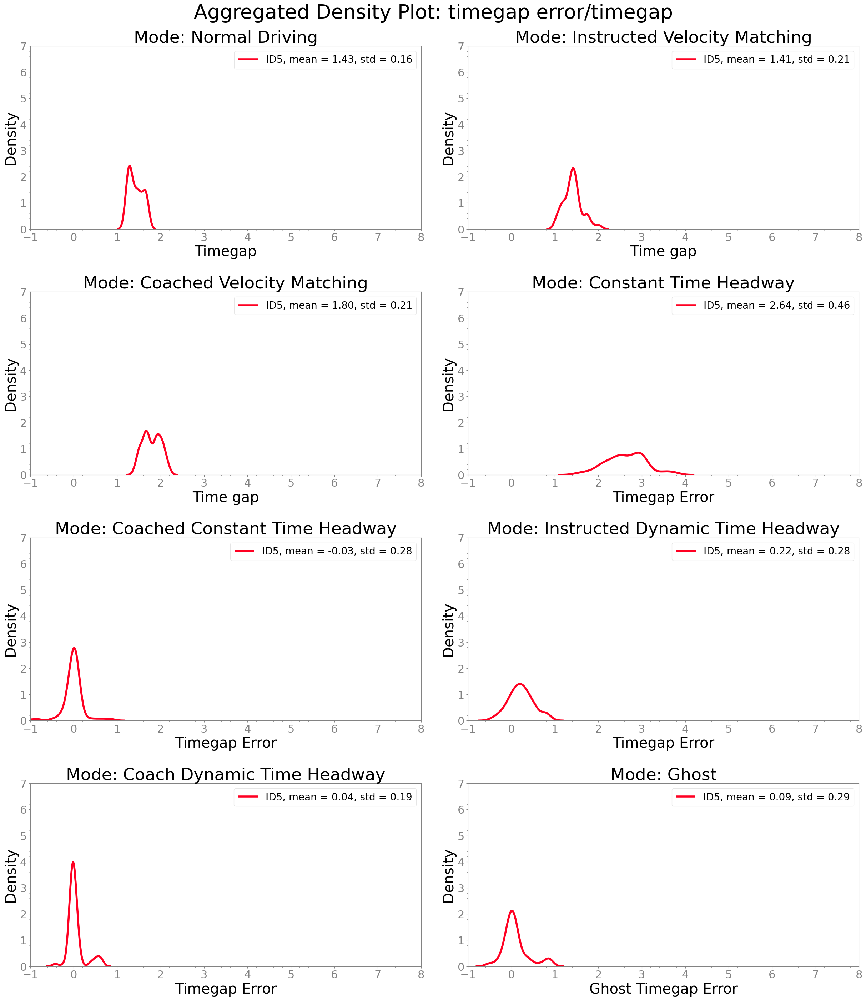

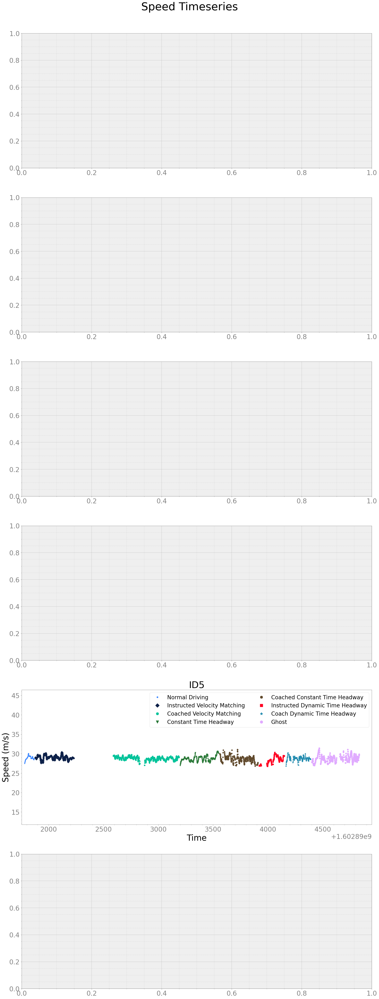

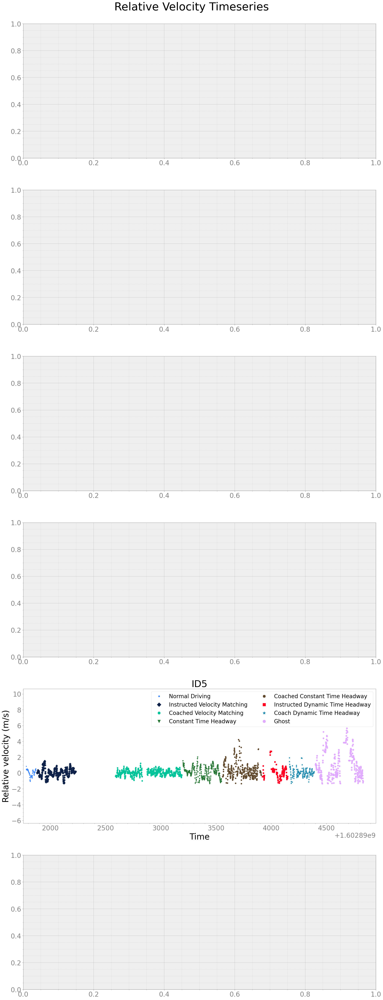

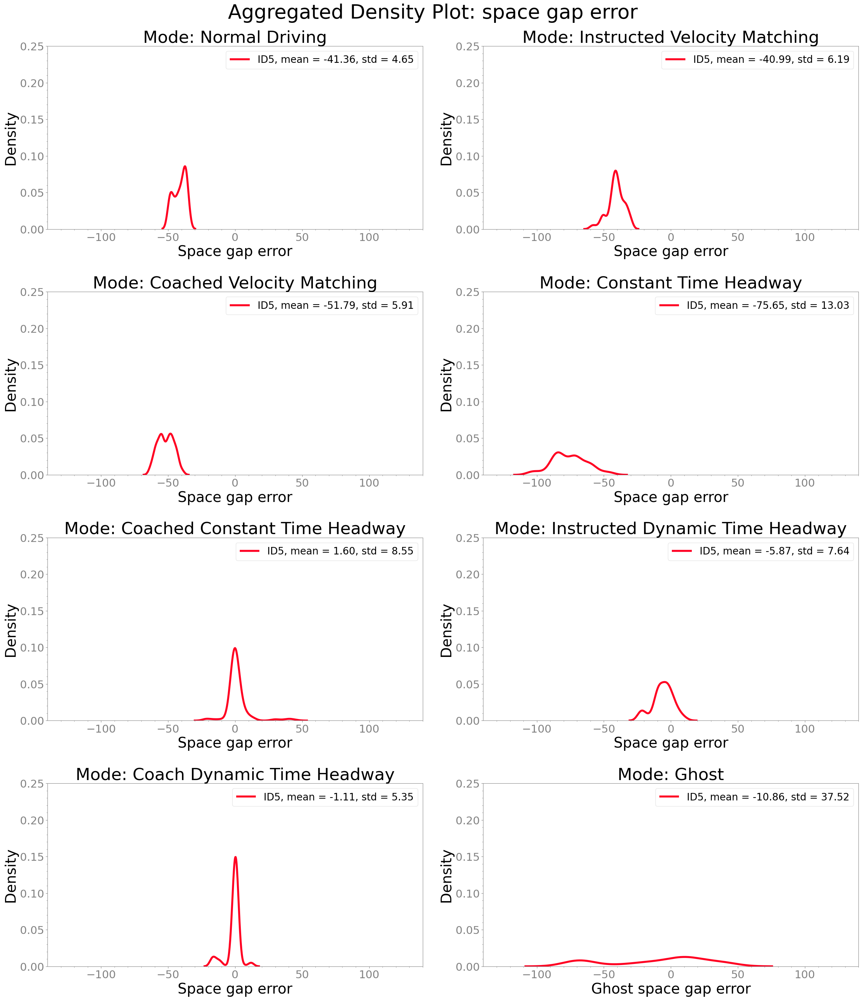

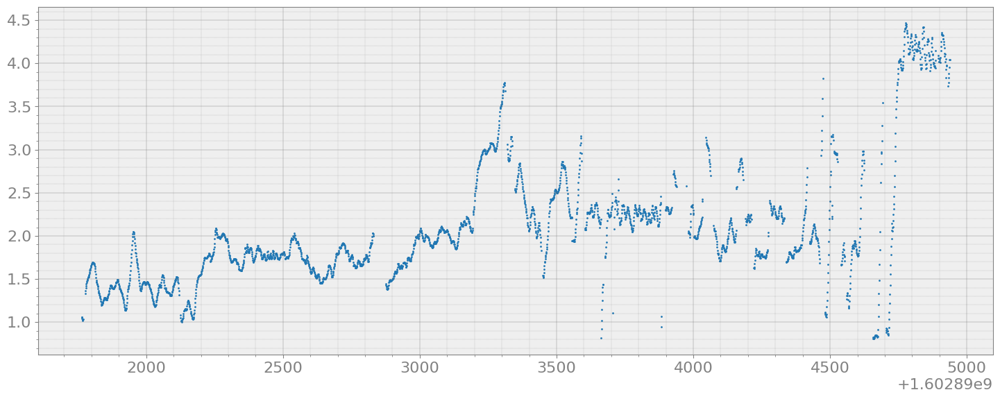

In [18]:
data = multi_bag_kde([b4])
fig, ax = bagpy.create_fig(1)
ax[0].scatter( x = data['Time'], y = data['timeheadway'], s= 1)

ID6
(2854, 11)
ID: ID6, Mode: 1
Clock
2020-10-16 23:40:03.289069891    0.932095
2020-10-16 23:40:04.289599180    0.913709
2020-10-16 23:40:05.290128469    0.899566
2020-10-16 23:40:06.290657759    0.853575
2020-10-16 23:40:07.291187286    0.822065
                                   ...   
2020-10-16 23:42:26.364765167    0.413931
2020-10-16 23:42:27.365294695    0.410498
2020-10-16 23:42:28.365823984    0.419427
2020-10-16 23:42:29.366353273    0.429437
2020-10-16 23:42:30.366882563    0.452110
Length: 148, dtype: float64
ID:5, mode: 1, mean: -21.15839333427607, stddev: 4.519388151973049
ID:5, mode: 6, mean: -32.517468428084356, stddev: 8.033044964942238
ID:5, mode: 7, mean: -80.43842467453439, stddev: 16.639695584595675
ID: ID6, Mode: 2
Clock
2020-10-17 00:04:42.071432114    2.818709
2020-10-17 00:04:43.071961641    2.778687
2020-10-17 00:04:44.072490931    2.733256
2020-10-17 00:04:45.073020220    2.696737
2020-10-17 00:04:46.073549509    2.670527
                                   .

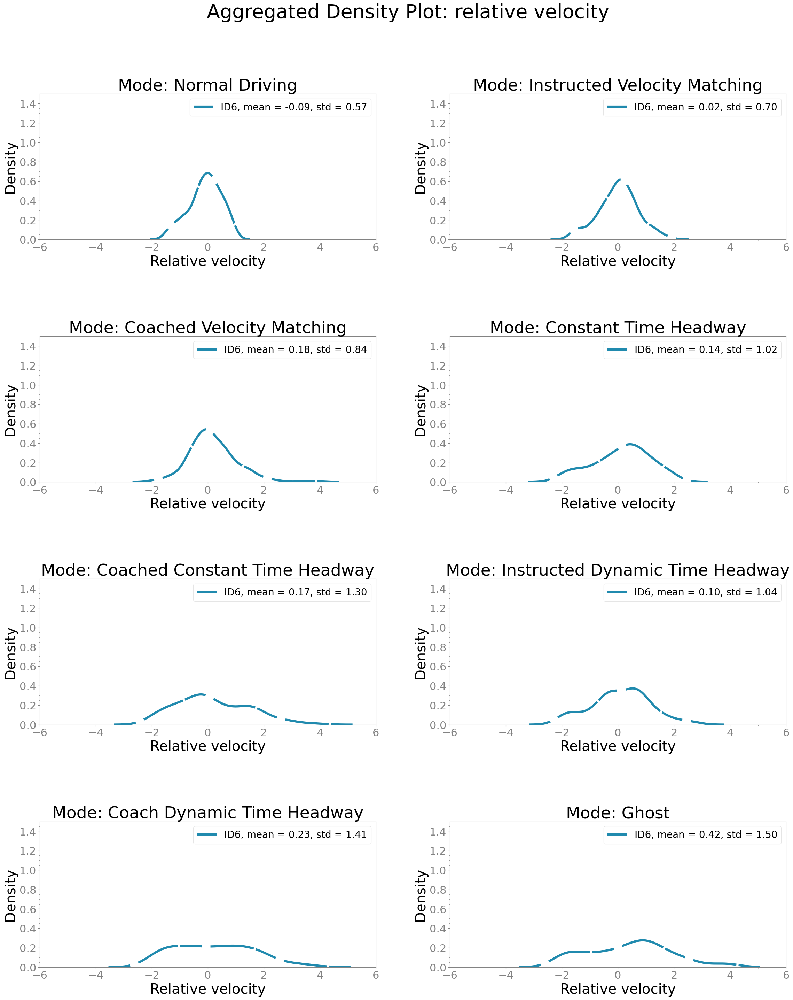

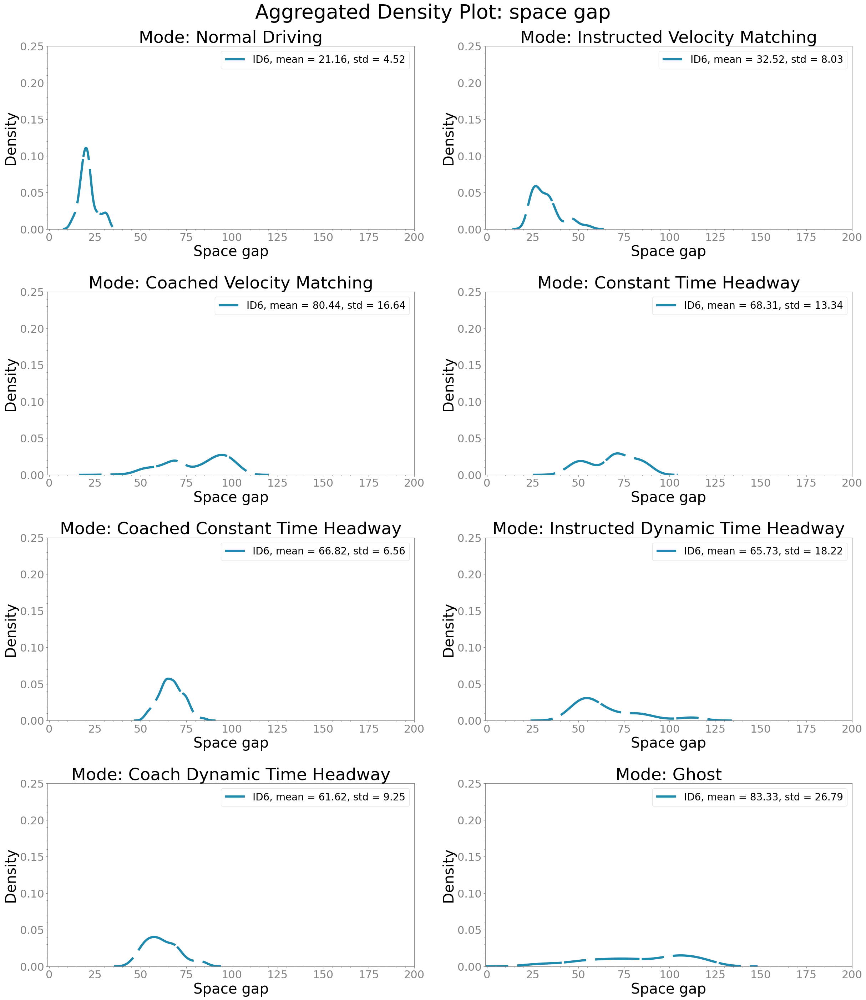

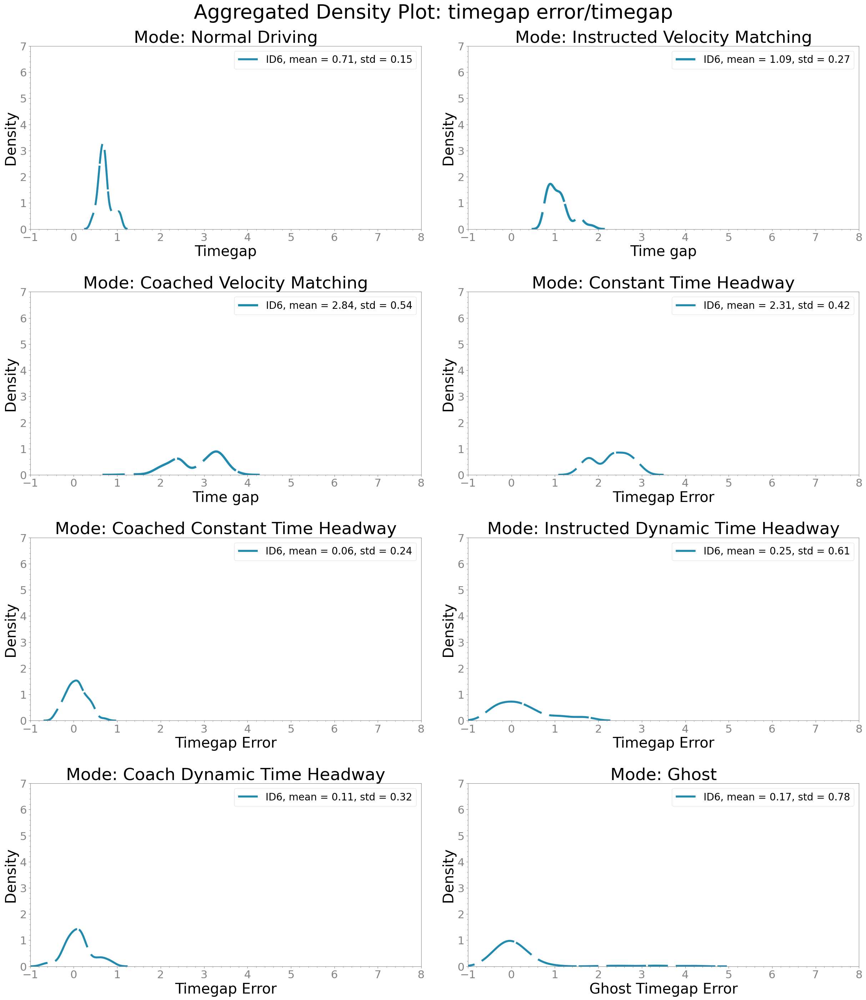

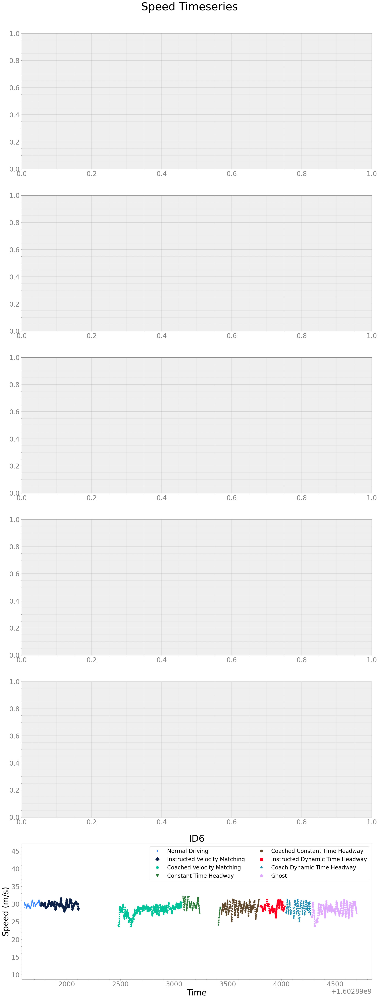

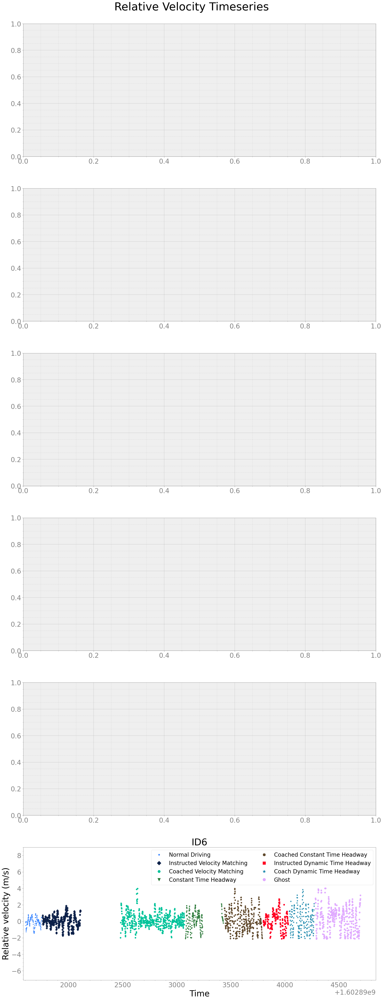

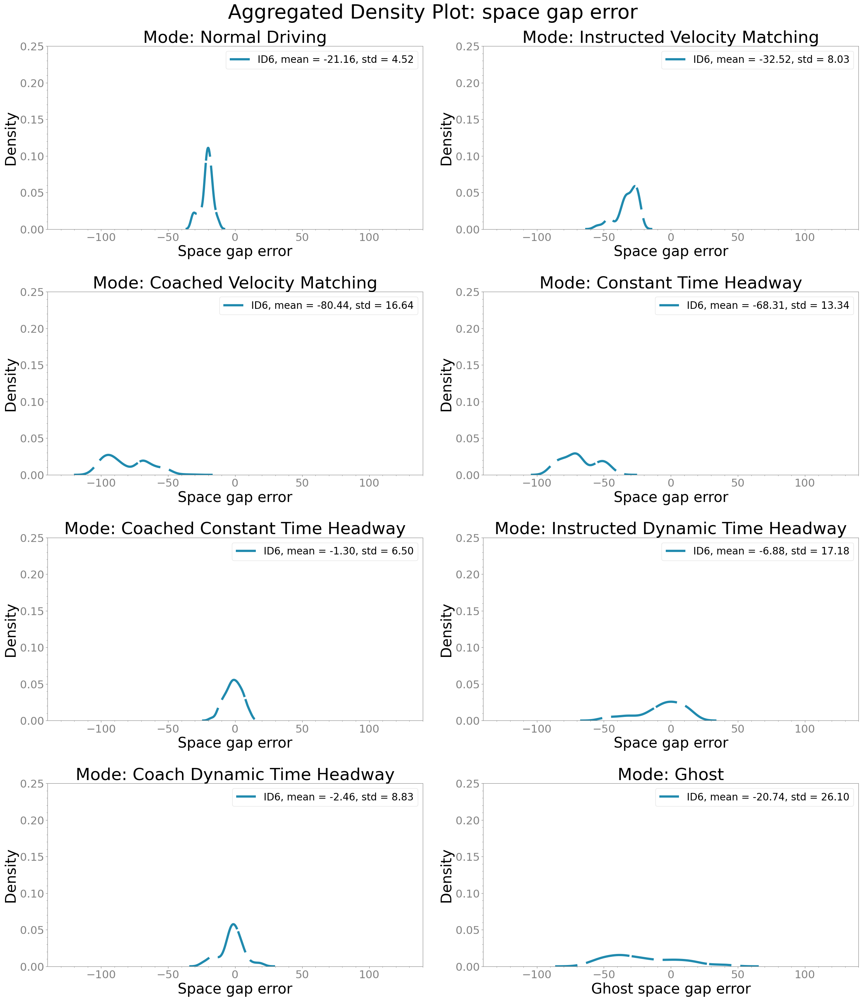

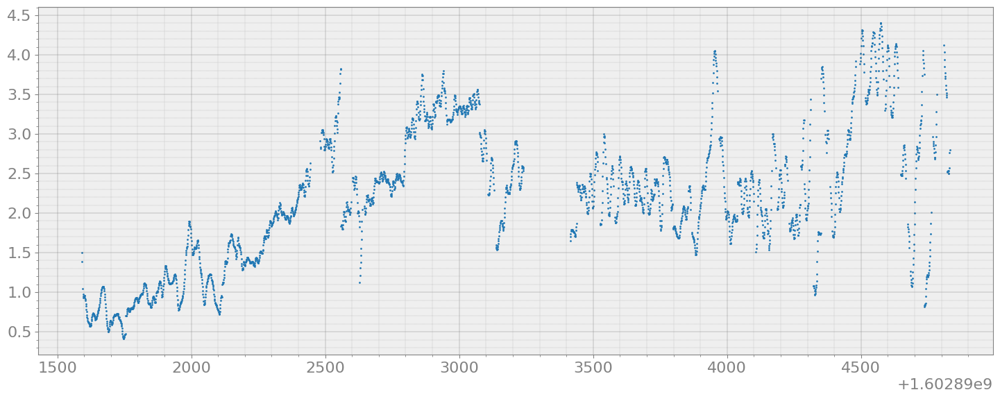

In [19]:
data = multi_bag_kde([b5])
fig, ax = bagpy.create_fig(1)
ax[0].scatter( x = data['Time'], y = data['timeheadway'], s= 1)

## Rosout Analysis

In [23]:
#rosout_file = b0.message_by_topic('/rosout')
#rosout = pd.read_csv(rosout_file)
#rosout

,Time,header.seq,header.stamp.secs,header.stamp.nsecs,header.frame_id,level,name,msg,file,function,line,topics
0,1.602548e+09,2,1602547695,852331120,NaN,2,/recorder,Subscribing to /rosout,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
1,1.602548e+09,3,1602547695,904252508,NaN,2,/recorder,Subscribing to /rosout_agg,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
2,1.602548e+09,0,1602547695,811591249,NaN,2,/vehicle/subs,Got parameter,/home/eternity/catkin_ws/src/can_to_ros/src/su...,main,627,['/rosout']
3,1.602548e+09,4,1602547696,946882767,NaN,2,/recorder,Subscribing to /highbeams,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
4,1.602548e+09,5,1602547696,996772637,NaN,2,/recorder,Subscribing to /track_a9,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
5,1.602548e+09,6,1602547697,44295193,NaN,2,/recorder,Subscribing to /track_a8,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
6,1.602548e+09,7,1602547697,87468674,NaN,2,/recorder,Subscribing to /vehicle/distanceEstimator/dist,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
7,1.602548e+09,8,1602547697,131617545,NaN,2,/recorder,Subscribing to /track_a1,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
8,1.602548e+09,9,1602547697,182735767,NaN,2,/recorder,Subscribing to /track_a0,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
9,1.602548e+09,10,1602547697,226756119,NaN,2,/recorder,Subscribing to /track_a3,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']


In [24]:
#rosoutagg_file = b0.message_by_topic('/rosout_agg')
#rosout_agg = pd.read_csv(rosoutagg_file)
#rosout_agg

,Time,header.seq,header.stamp.secs,header.stamp.nsecs,header.frame_id,level,name,msg,file,function,line,topics
0,1.602548e+09,2,1602547696,946882767,NaN,2,/recorder,Subscribing to /highbeams,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
1,1.602548e+09,3,1602547696,996772637,NaN,2,/recorder,Subscribing to /track_a9,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
2,1.602548e+09,4,1602547697,44295193,NaN,2,/recorder,Subscribing to /track_a8,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
3,1.602548e+09,5,1602547697,87468674,NaN,2,/recorder,Subscribing to /vehicle/distanceEstimator/dist,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
4,1.602548e+09,6,1602547697,131617545,NaN,2,/recorder,Subscribing to /track_a1,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
5,1.602548e+09,7,1602547697,182735767,NaN,2,/recorder,Subscribing to /track_a0,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
6,1.602548e+09,8,1602547697,226756119,NaN,2,/recorder,Subscribing to /track_a3,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
7,1.602548e+09,9,1602547697,280935341,NaN,2,/recorder,Subscribing to /track_a2,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
8,1.602548e+09,10,1602547697,338078174,NaN,2,/recorder,Subscribing to /track_a5,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
9,1.602548e+09,11,1602547697,396613211,NaN,2,/recorder,Subscribing to /track_a4,/tmp/binarydeb/ros-melodic-rosbag-1.14.5/src/r...,shared_ptr<ros::Subscriber> rosbag::Recorder::...,213,['/rosout']
